In [1]:
##################################################################################################################
##################################################################################################################
###############################################ngrams representation###############################################
##################################################################################################################
##################################################################################################################

In [2]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

import gensim
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel
from sklearn.feature_extraction.text import TfidfVectorizer

import nltk
#nltk.download()
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
from nltk.stem.wordnet import WordNetLemmatizer
nltk.download('wordnet')
dictionary_words = set(nltk.corpus.words.words())

from pprint import pprint

from textblob import TextBlob, Word

import spacy
import spacy_legacy
#loading the english language small model of spacy
en = spacy.load('en_core_web_sm')
sw_spacy = en.Defaults.stop_words


import pickle
import re 
import pyLDAvis
import pyLDAvis.gensim_models

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ahwah\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ahwah\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [4]:
df = pd.read_csv ('Mychart.csv', encoding='utf-8')

In [5]:
df.shape

(39999, 1)

In [6]:
df.head()

,Review
0,Convenient
1,Best way to keep my medical needs in the loop.
2,Doesn't work any more. I have called to reset ...
3,Excellent
4,Easy to use


In [7]:
df= df.apply(lambda x: x.astype(str).str.lower())

In [8]:
#Remove non english tweets
nlp = spacy.load("en_core_web_sm")
STOPWORDS_DICT = {lang: set(nltk.corpus.stopwords.words(lang)) for lang in nltk.corpus.stopwords.fileids()}

# def get_language(text):
#     #Determines what language the comment is written in and filters only English comments.
#     words = set(nltk.wordpunct_tokenize(text.lower()))
#     return max(((lang, len(words & stopwords)) for lang, stopwords in STOPWORDS_DICT.items()), key = lambda x: x[1])[0]

# df['language'] = df['Review'].map(get_language)
# df = df.loc[df['language'] == 'english']
# df = df.drop('language', axis=1)
# df = df[df['Review'] != ""]

In [9]:
df.shape

(39999, 1)

In [10]:
df= df.apply(lambda x: x.astype(str).str.lower())

In [11]:
df.shape

(39999, 1)

# Pre-processing

In [12]:
docs = np.array(df['Review'])

In [13]:
def clean_tweets(docs):
    for i in range(len(docs)):
        #remove hashtags and mentions
        docs[i] = " ".join(filter(lambda x:x[0]!='#', docs[i].split())) #remove hashtags
        docs[i] = " ".join(filter(lambda x:x[0]!='@', docs[i].split())) #remove mentiones
        
        #Remove stop words using spacy
        words = [word for word in docs[i].split() if word.lower() not in sw_spacy]
        docs[i] = " ".join(words)
        
        #Remove stop words using nltk
        words = [word for word in docs[i].split() if word.lower() not in stopwords.words('english')]
        docs[i] = " ".join(words)
        
        #remove special chars, anything not a number or letter, anything excpet alphanumeric words
        docs[i] = re.sub(r'[^\w\s]','',docs[i]) #remove punctuation marks and special chars
        docs[i] = re.sub('[^A-Za-z0-9]+', ' ', docs[i]) #remove anything that is not a number or or letter
        docs[i] = re.sub('[\W_]', ' ', docs[i]) #Remove any thing excpet charcater and alphanumeric words
        docs[i] = re.sub(r'\w*\d\w*', '', docs[i]) #Remove any thing with numbers
        docs[i] = ' '.join(word for word in docs[i].split() if not word.isdigit())
        
        #compare words to englisg dictionary and remove nonsense words
        words = [word for word in docs[i].split() if word.lower() in dictionary_words or not word.isalpha()]
        docs[i] = " ".join(words)
        
        #remove words that consists of less than three letter
        words = [word for word in docs[i].split() if len(word)>2]
        docs[i] = " ".join(words)
                             
        #Lemmatize each tweet
        sent = TextBlob(docs[i])
        docs[i] = " ". join([w.lemmatize() for w in sent.words])
    return docs

<>:18: DeprecationWarning: invalid escape sequence '\W'
<>:18: DeprecationWarning: invalid escape sequence '\W'
C:\Users\ahwah\AppData\Local\Temp\ipykernel_40204\2661817374.py:18: DeprecationWarning: invalid escape sequence '\W'
  docs[i] = re.sub('[\W_]', ' ', docs[i]) #Remove any thing excpet charcater and alphanumeric words


In [14]:
processed_docs = clean_tweets(docs)

In [15]:
processed_docs

array(['convenient', 'best way medical need loop',
       'work more reset password got time reset password again got cant login again',
       ..., 'easy use love', 'able update information good system',
       'like easy use handy'], dtype=object)

# Generate bigram and trigram

In [16]:
from nltk import ngrams
ngram_list = []
for i in range(len(processed_docs)):
    doc = processed_docs[i]
    bigram = ngrams(doc.split(' '), n=2)
    #trigram = ngrams(doc.split(' '), n=3)
    ngram_docs = []
    for x in bigram:
        ngram_docs.append(' '.join(x))
    #for y in trigram:
        #ngram_docs.append(' '.join(y))
    ngram_list.append(ngram_docs)

In [17]:
ngram_list[1]

['best way', 'way medical', 'medical need', 'need loop']

In [18]:
docs = ngram_list

In [19]:
from gensim.corpora import Dictionary

# Create a dictionary representation of the documents.
docs_dict = Dictionary(docs)
print('Number of unique words in initital documents:', len(docs_dict))

# #Filter out words that occur less than 10 documents, or more than 40% of the documents.
# docs_dict.filter_extremes(no_below=2, no_above=0.60)
# print('Number of unique words after removing rare and common words:', len(docs_dict))

Number of unique words in initital documents: 96977


In [20]:
for key, i in docs_dict.items():
    print(key, i)

0 best way
1 medical need
2 need loop
3 way medical
4 again got
5 cant login
6 got cant
7 got time
8 login again
9 more reset
10 password again
11 password got
12 reset password
13 time reset
14 work more
15 easy use
16 doctor inform
17 educate speak
18 inform educate
19 myself small
20 small town
21 speak them
22 that myself
23 them that
24 town practice
25 account set
26 across guess
27 change forward
28 change function
29 come across
30 current password
31 especially account
32 fact password
33 forward certainly
34 function current
35 generally new
36 guess real
37 idea want
38 little change
39 little thought
40 new password
41 password change
42 password generally
43 password idea
44 password set
45 real world
46 set come
47 set little
48 testing especially
49 thought little
50 want current
51 world testing
52 convenient easy
53 helpful convenient
54 able blood
55 appointment hospital
56 blood work
57 chance home
58 compare previous
59 definitely recommend
60 fully understand
61 ho

37077 looking learn
37078 maybe finding
37079 missing basic
37080 part link
37081 specifically looking
37082 way think
37083 area reason
37084 best breaking
37085 breaking neck
37086 choose area
37087 extent told
37088 issue ortho
37089 message issue
37090 neck spine
37091 need choose
37092 ortho getting
37093 reason extent
37094 spine answer
37095 told best
37096 touch helpful
37097 find huge
37098 huge timesaving
37099 look read
37100 bull way
37101 button disabled
37102 control freak
37103 disabled guarantee
37104 dumb try
37105 epic control
37106 freak let
37107 genius remember
37108 guarantee tied
37109 lapse reply
37110 message lapse
37111 message shown
37112 need genius
37113 old phone
37114 original message
37115 phone theyre
37116 provider original
37117 remember said
37118 reply button
37119 said message
37120 shown need
37121 theyre dumb
37122 tied bull
37123 try reply
37124 communicate overwhelming
37125 overwhelming size
37126 receive office
37127 size easy
37128 think med

38842 life possibly
38843 more life
38844 possibly saved
38845 went different
38846 like god
38847 like swap
38848 swap medical
38849 business weird
38850 correctly business
38851 amazing upcoming
38852 list more
38853 more user
38854 phone list
38855 cant hate
38856 anything multiple
38857 despite multiple
38858 help anything
38859 line useless
38860 multiple care
38861 office useless
38862 support line
38863 team despite
38864 time care
38865 use useless
38866 useless help
38867 useless support
38868 staff hold
38869 appointment organized
38870 enjoying access
38871 medical fast
38872 fabulous highly
38873 health fabulous
38874 recommend breeze
38875 let all
38876 cant follow
38877 day sure
38878 follow protocol
38879 difficult cancel
38880 able future
38881 connect internally
38882 future connect
38883 internally team
38884 past see
38885 track past
38886 appreciate option
38887 making seeing
38888 not appreciate
38889 want not
38890 outstanding provided
38891 are fast
38892 dont gu

78971 invention medical
78972 medical seriously
78973 seriously communication
78974 health assistance
78975 easy private
78976 private love
78977 thought hard
78978 young thought
78979 gad option
78980 old provider
78981 option purpose
78982 provider gad
78983 refill old
78984 cant back
78985 chart fine
78986 fine till
78987 till got
78988 easy team
78989 love supposed
78990 changer easy
78991 allow tho
78992 billing allow
78993 find super
78994 fine special
78995 helpful billing
78996 special find
78997 like experience
78998 come communication
78999 safe eliminate
79000 easy format
79001 but procedure
79002 medical but
79003 procedure reminder
79004 reminder stay
79005 rid incredibly
79006 stay cant
79007 medication script
79008 nurse schedule
79009 script out
79010 footprint past
79011 future perspective
79012 medical footprint
79013 perspective tool
79014 resource complete
79015 room chart
79016 waiting come
79017 waiting extra
79018 work waiting
79019 great perfect
79020 convenient

In [21]:
# with open('dict.csv', 'w') as csv_file:
#     writer = csv.writer(csv_file)
#     for key, value in  docs_dict.items():
#         writer.writerow([key, value])

In [22]:
#bag of words representation
corpus = [docs_dict.doc2bow(doc) for doc in docs]
corpus[0]

[]

In [23]:
corpus[55]

[(360, 1),
 (361, 1),
 (362, 1),
 (363, 1),
 (364, 1),
 (365, 1),
 (366, 1),
 (367, 1),
 (368, 1),
 (369, 1),
 (370, 1),
 (371, 1),
 (372, 1),
 (373, 1)]

In [24]:
print('Number of unique tokens: %d' % len(docs_dict))
print('Number of documents: %d' % len(corpus))

Number of unique tokens: 96977
Number of documents: 39999


# LDA topic model

In [25]:
from gensim.models import LdaModel
from gensim.models import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel

In [26]:
##MultiCore LDA Model

In [27]:
import logging

# Set up log to external log file
# Remove all handlers associated with the root logger object.
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)
    
logging.basicConfig(filename='lda_model.log', format='%(asctime)s : %(levelname)s : %(message)s', 
                    level=logging.INFO)

In [28]:
# Set training parameters.
num_topics = 50
chunksize = 10000 # size of the doc looked at every pass
passes = 5 # number of passes through documents
iterations = 5
eval_every = 1  # Don't evaluate model perplexity, takes too much time.

# Make an index to word dictionary.
temp = docs_dict[0]  # This is only to "load" the dictionary.
id2word = docs_dict.id2token

%time model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, eval_every=eval_every, workers=13)

CPU times: total: 15.5 s
Wall time: 36.4 s


In [29]:
# Compute model Perplexity - a measure of how good the model is. lower the better`
print('\nPerplexity: ', model.log_perplexity(corpus,total_docs=9958))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=model, texts=docs, dictionary=docs_dict , coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -24.052030351308296

Coherence Score:  0.5429283623147367


# Creating a base model

In [30]:
%time model = LdaModel(corpus=corpus, id2word=id2word, num_topics = 50, random_state=100, \
                       chunksize=10000, passes=10)

CPU times: total: 58.7 s
Wall time: 1min 13s


In [31]:
 #How good a given topic model is?
    
# Compute model Perplexity - a measure of how good the model is. lower the better`
print('\nPerplexity: ', model.log_perplexity(corpus,total_docs=9778))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=model, texts=docs, dictionary=docs_dict , coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -37.135741454299435

Coherence Score:  0.6420747390407401


# Improve Coherence: Optimizing LDA Model

In [32]:
def compute_coherence_values(id2word, dictionary, corpus, texts, limit, start=2, step=1):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    
    # Fixed LDA model parameters
    chunksize = 5000 # size of the doc looked at every pass
    passes = 10 # number of passes through documents
    iterations = 10
    #eval_every = 10  # Don't evaluate model perplexity, takes too much time.

    coherence_values = []
    #perplexity_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        print("LDA model with ", num_topics, "topics")
        model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, workers=13)       
        model_list.append(model)
        
        print("Calculating coherence score")
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
        #print("Calculating perplexity score")
        #perplexity_values.append(model.log_perplexity(corpus,total_docs=8933)) 

    #return model_list, coherence_values, perplexity_values
    return model_list, coherence_values

In [33]:
model_list, coherence_values = compute_coherence_values(id2word=id2word, dictionary=docs_dict, \
                                                        corpus=corpus, texts=docs, start=2, limit=101, step=1)

# model_list, coherence_values, perplexity_values = compute_coherence_values(id2word=id2word, dictionary=docs_dict, \
#                                                         corpus=corpus, texts=docs, start=2, limit=101, step=1)

LDA model with  2 topics
Calculating coherence score
LDA model with  3 topics
Calculating coherence score
LDA model with  4 topics
Calculating coherence score
LDA model with  5 topics
Calculating coherence score
LDA model with  6 topics
Calculating coherence score
LDA model with  7 topics
Calculating coherence score
LDA model with  8 topics
Calculating coherence score
LDA model with  9 topics
Calculating coherence score
LDA model with  10 topics
Calculating coherence score
LDA model with  11 topics
Calculating coherence score
LDA model with  12 topics
Calculating coherence score
LDA model with  13 topics
Calculating coherence score
LDA model with  14 topics
Calculating coherence score
LDA model with  15 topics
Calculating coherence score
LDA model with  16 topics
Calculating coherence score
LDA model with  17 topics
Calculating coherence score
LDA model with  18 topics
Calculating coherence score
LDA model with  19 topics
Calculating coherence score
LDA model with  20 topics
Calculatin

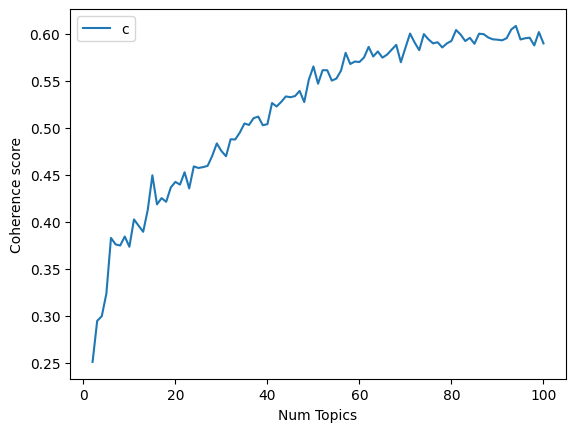

In [34]:
# Show graph
limit=101; start=2; step=1;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()# Print the coherence scores

In [35]:
# # Show graph
# limit=101; start=2; step=1;
# x = range(start, limit, step)
# plt.plot(x, perplexity_values)
# plt.xlabel("Num Topics")
# plt.ylabel("Perplexity score")
# plt.legend(("perplexity_score"), loc='best')
# plt.show()# Print the perplexity scores

In [36]:
# import numpy as np 
# rows = [coherence_values, perplexity_values] 
# np.savetxt("scores.csv",rows, delimiter =" ",  fmt ='% s')

In [37]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.2512
Num Topics = 3  has Coherence Value of 0.2948
Num Topics = 4  has Coherence Value of 0.2998
Num Topics = 5  has Coherence Value of 0.3238
Num Topics = 6  has Coherence Value of 0.3829
Num Topics = 7  has Coherence Value of 0.3761
Num Topics = 8  has Coherence Value of 0.3749
Num Topics = 9  has Coherence Value of 0.3844
Num Topics = 10  has Coherence Value of 0.3735
Num Topics = 11  has Coherence Value of 0.4026
Num Topics = 12  has Coherence Value of 0.396
Num Topics = 13  has Coherence Value of 0.3894
Num Topics = 14  has Coherence Value of 0.413
Num Topics = 15  has Coherence Value of 0.4495
Num Topics = 16  has Coherence Value of 0.4186
Num Topics = 17  has Coherence Value of 0.4252
Num Topics = 18  has Coherence Value of 0.4213
Num Topics = 19  has Coherence Value of 0.4365
Num Topics = 20  has Coherence Value of 0.4425
Num Topics = 21  has Coherence Value of 0.4396
Num Topics = 22  has Coherence Value of 0.4527
Num Topics = 23  has Co

In [ ]:
#######################################################################

In [38]:
# Set training parameters.
num_topics = 94
chunksize = 5000 # size of the doc looked at every pass
passes = 10 #number of passes through documents
iterations = 10
#eval_every = 10  # Don't evaluate model perplexity, takes too much time.

# Make an index to word dictionary.
temp = docs_dict[0]  # This is only to "load" the dictionary.
id2word = docs_dict.id2token

%time model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, workers=13)   

CPU times: total: 32.5 s
Wall time: 1min 18s


In [39]:
#Print all the topics
for i in range(0, model.num_topics):
    print ('Topic', i+1 , ' ', model.print_topic(i))
    print("-------------------------------------------------------------")

Topic 1   0.039*"helpful easy" + 0.022*"love health" + 0.011*"easy use" + 0.010*"easy work" + 0.007*"wait time" + 0.006*"staff great" + 0.006*"access doctor" + 0.005*"information like" + 0.004*"great care" + 0.004*"great know"
-------------------------------------------------------------
Topic 2   0.015*"great track" + 0.007*"health great" + 0.007*"miss appointment" + 0.006*"cancel appointment" + 0.005*"handy easy" + 0.004*"chat doctor" + 0.004*"easy user" + 0.004*"receive information" + 0.004*"track doctor" + 0.004*"test check"
-------------------------------------------------------------
Topic 3   0.032*"easy communicate" + 0.009*"test faster" + 0.008*"appreciate able" + 0.006*"test send" + 0.006*"find easy" + 0.006*"place great" + 0.004*"far great" + 0.004*"medical history" + 0.004*"able link" + 0.004*"message schedule"
-------------------------------------------------------------
Topic 4   0.058*"use love" + 0.057*"easy use" + 0.043*"super easy" + 0.019*"test doctor" + 0.018*"send 

Topic 29   0.010*"lot time" + 0.009*"need help" + 0.007*"good use" + 0.007*"excellent communication" + 0.007*"like ability" + 0.005*"use excellent" + 0.005*"feel comfortable" + 0.004*"good good" + 0.004*"instead calling" + 0.003*"information work"
-------------------------------------------------------------
Topic 30   0.013*"love way" + 0.012*"blood test" + 0.011*"love thank" + 0.007*"great far" + 0.007*"way connect" + 0.006*"user interface" + 0.005*"thank much" + 0.005*"getting medical" + 0.004*"medical treatment" + 0.004*"trying schedule"
-------------------------------------------------------------
Topic 31   0.017*"love doctor" + 0.016*"helpful love" + 0.010*"easy communication" + 0.008*"cant sign" + 0.007*"user friendly" + 0.006*"friendly love" + 0.006*"convenient like" + 0.005*"excellent care" + 0.005*"view information" + 0.005*"tool track"
-------------------------------------------------------------
Topic 32   0.014*"check appointment" + 0.013*"doctor great" + 0.010*"time save

Topic 61   0.134*"easy navigate" + 0.078*"easy access" + 0.024*"access information" + 0.023*"love easy" + 0.010*"good job" + 0.008*"change password" + 0.008*"great easy" + 0.007*"readily available" + 0.006*"health care" + 0.006*"test message"
-------------------------------------------------------------
Topic 62   0.011*"communicate staff" + 0.009*"use thank" + 0.006*"convenient need" + 0.006*"need doctor" + 0.006*"love application" + 0.006*"fast test" + 0.005*"cant print" + 0.005*"track upcoming" + 0.005*"thank god" + 0.005*"able sign"
-------------------------------------------------------------
Topic 63   0.039*"quick easy" + 0.021*"lot easier" + 0.015*"easy follow" + 0.015*"use access" + 0.014*"easy use" + 0.008*"date health" + 0.008*"wish medical" + 0.007*"best care" + 0.007*"health care" + 0.006*"use find"
-------------------------------------------------------------
Topic 64   0.010*"use date" + 0.009*"helpful thank" + 0.008*"palm hand" + 0.006*"instead waiting" + 0.006*"send re

Topic 93   0.019*"convenient way" + 0.007*"office visit" + 0.007*"reach doctor" + 0.006*"let log" + 0.006*"care medical" + 0.006*"way communicate" + 0.006*"way reach" + 0.005*"time information" + 0.005*"great lot" + 0.004*"great reminder"
-------------------------------------------------------------
Topic 94   0.035*"great love" + 0.017*"cant find" + 0.012*"like fact" + 0.011*"review test" + 0.009*"chart test" + 0.008*"remember password" + 0.006*"love work" + 0.006*"love chart" + 0.005*"able quickly" + 0.005*"trouble getting"
-------------------------------------------------------------


# Visualize 'optimal' LDA model

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


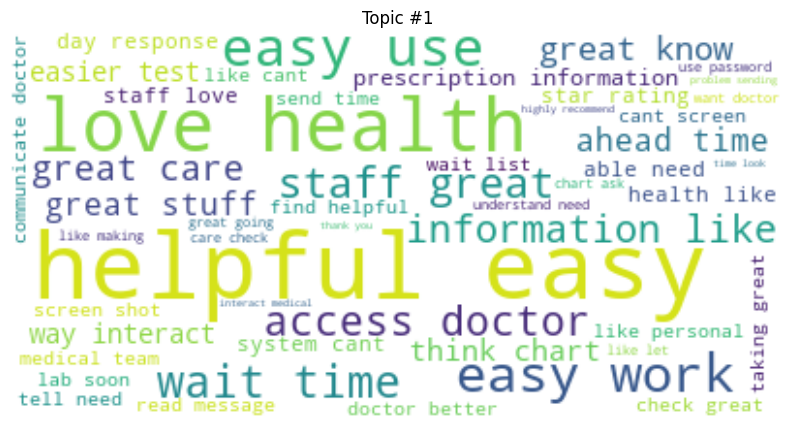

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


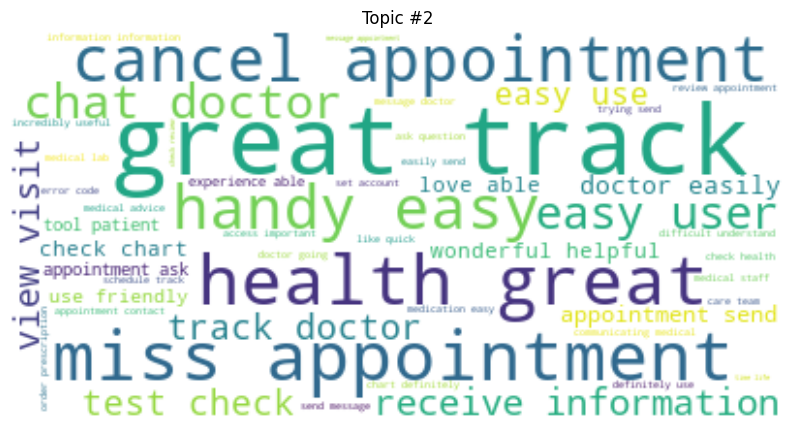

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


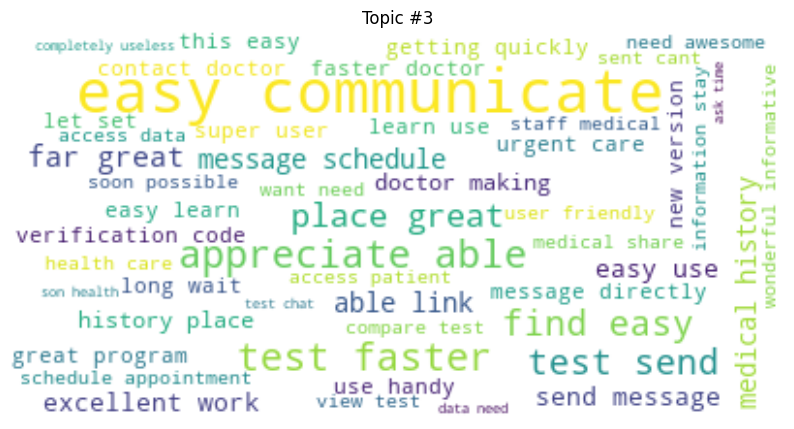

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


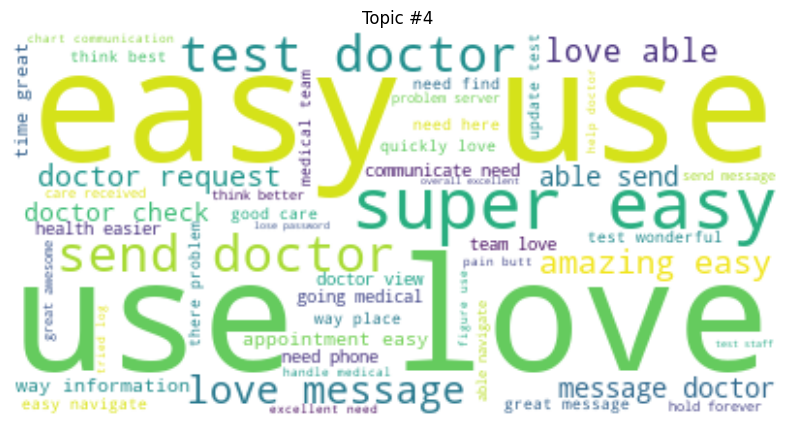

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


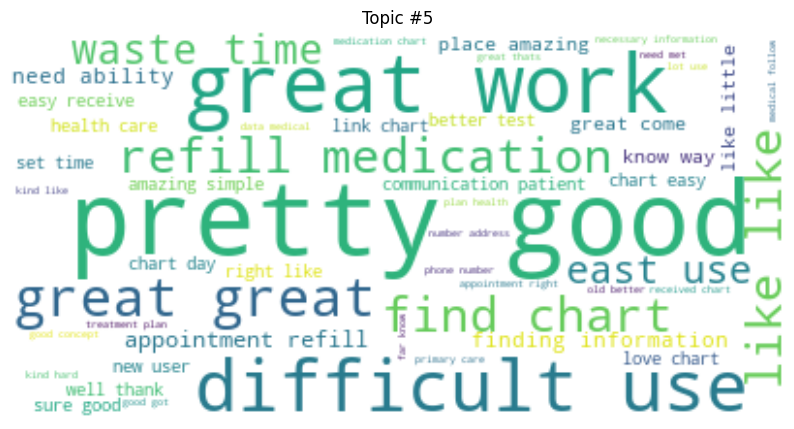

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


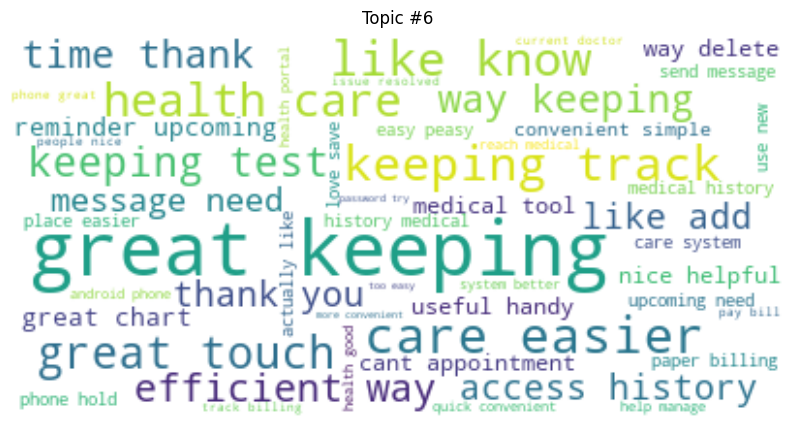

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


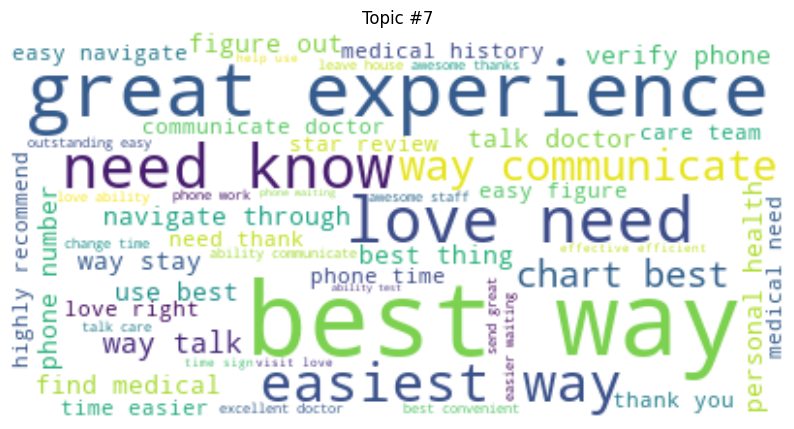

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


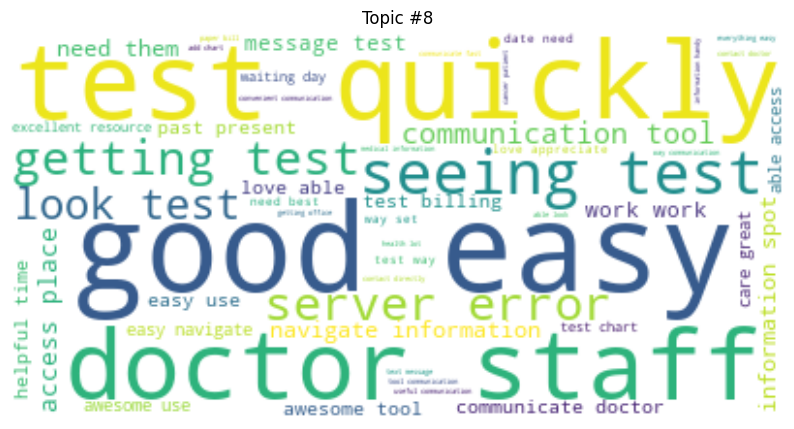

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


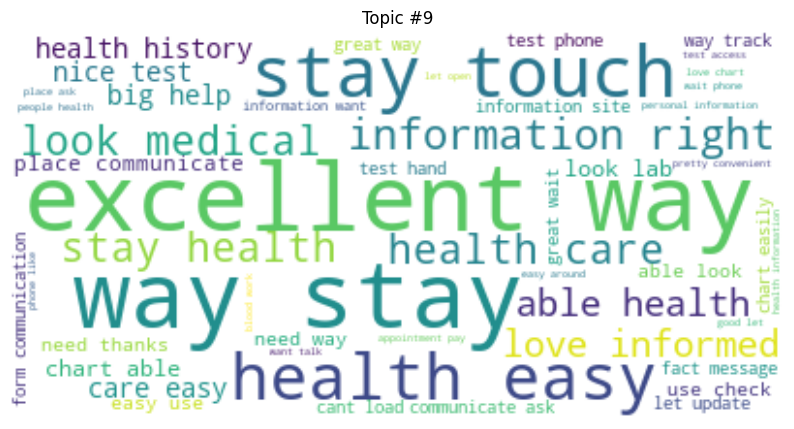

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


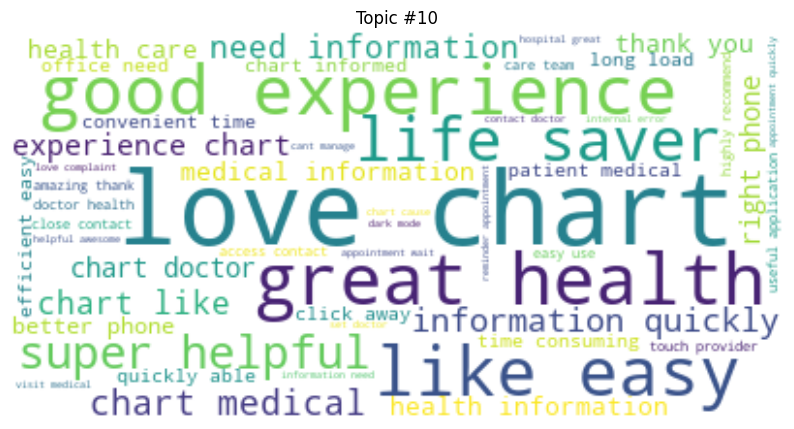

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


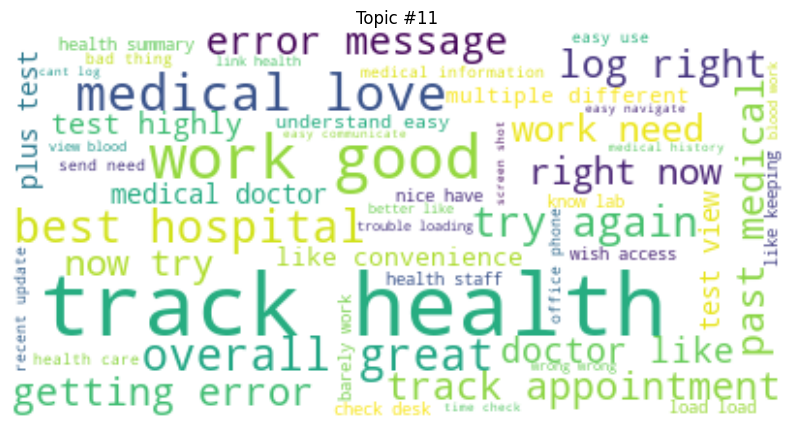

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


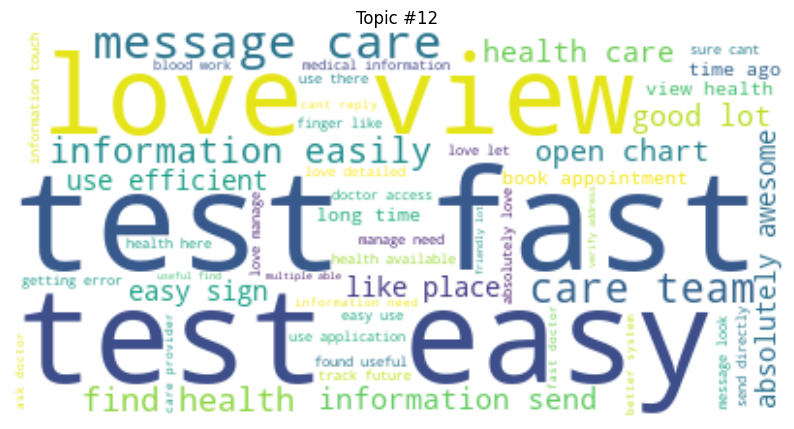

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


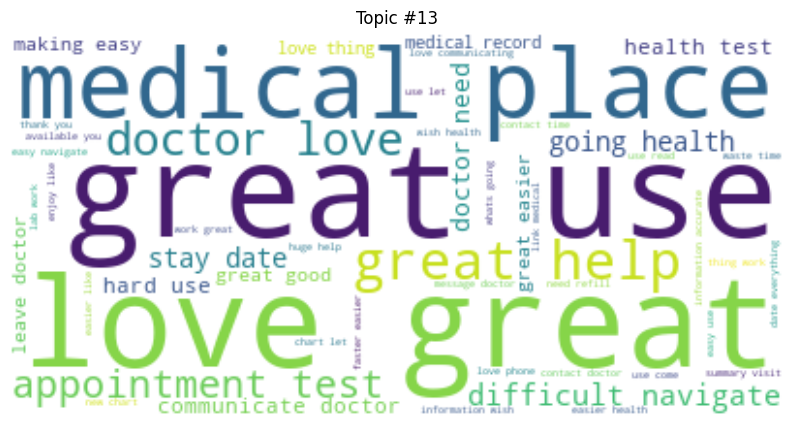

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


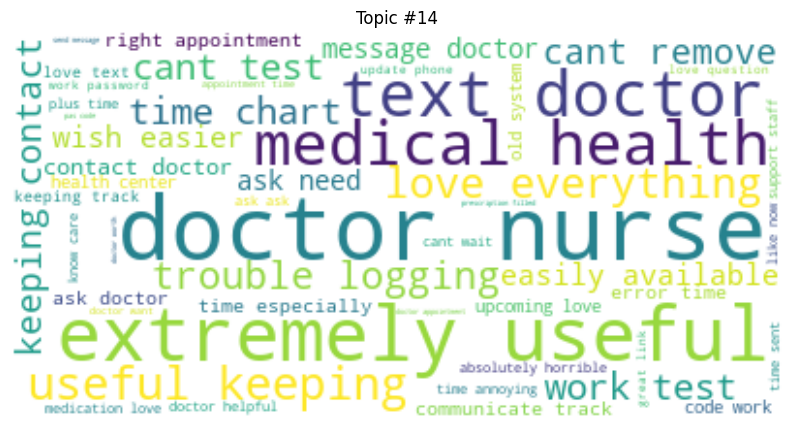

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


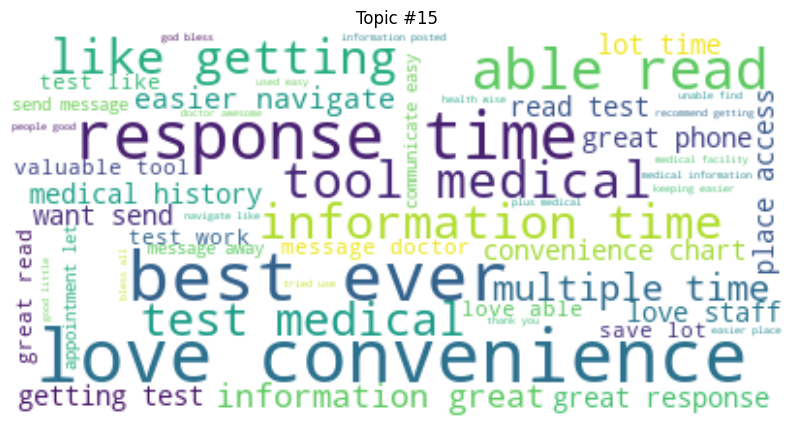

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


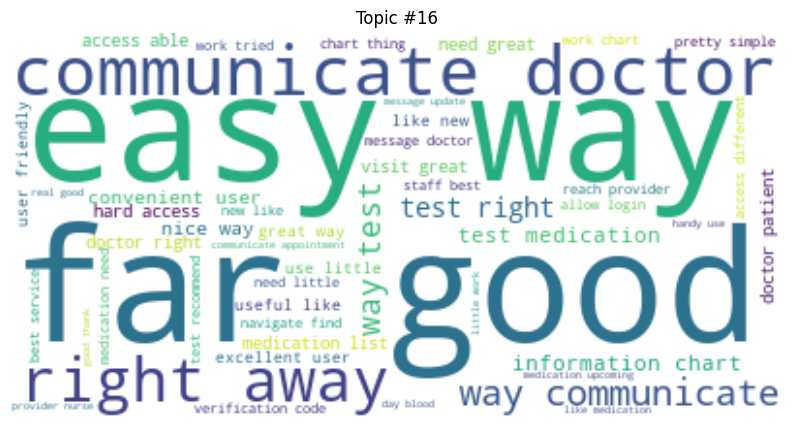

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


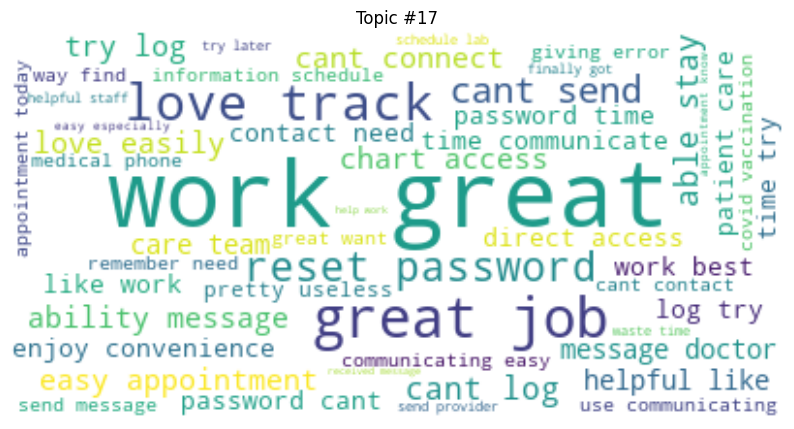

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


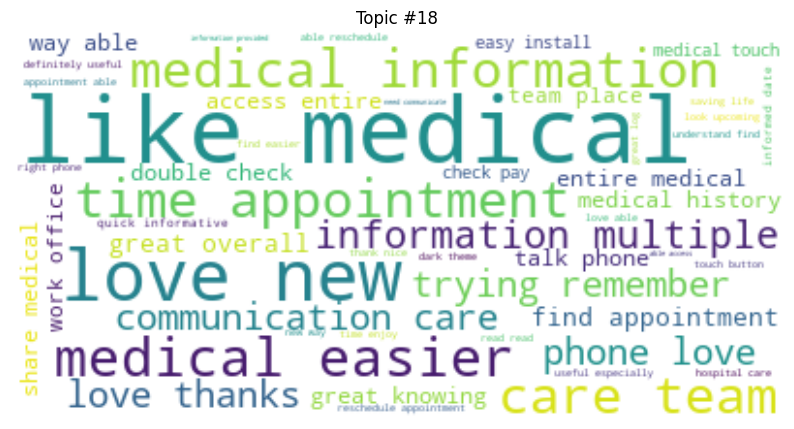

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


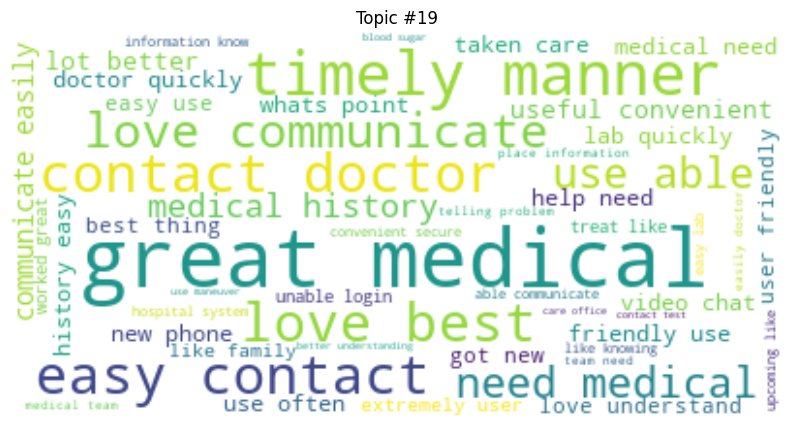

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


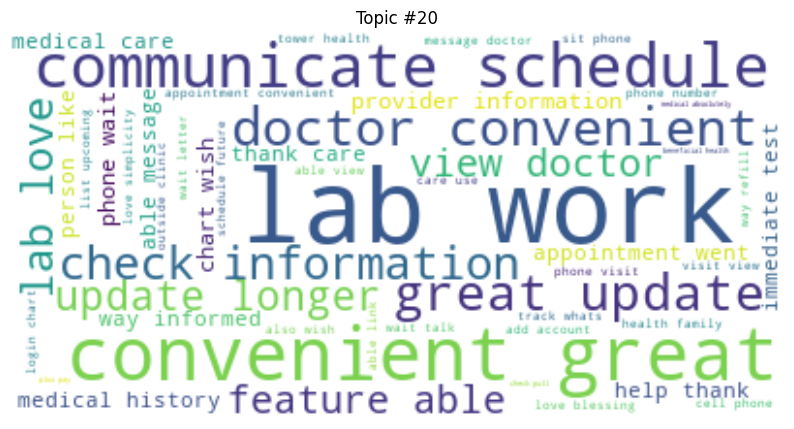

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


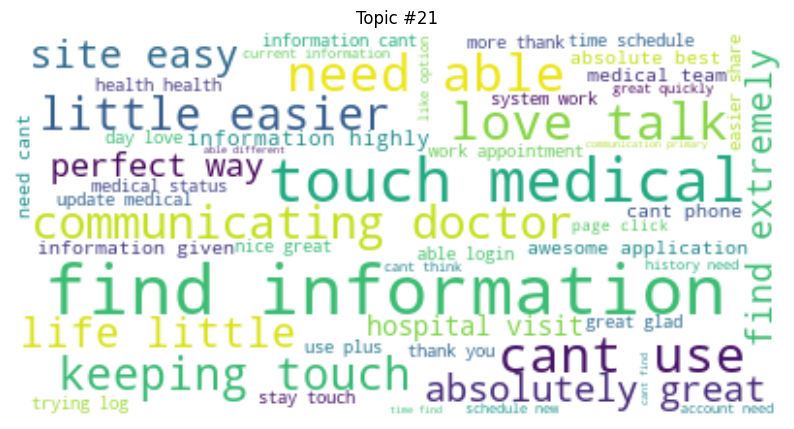

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


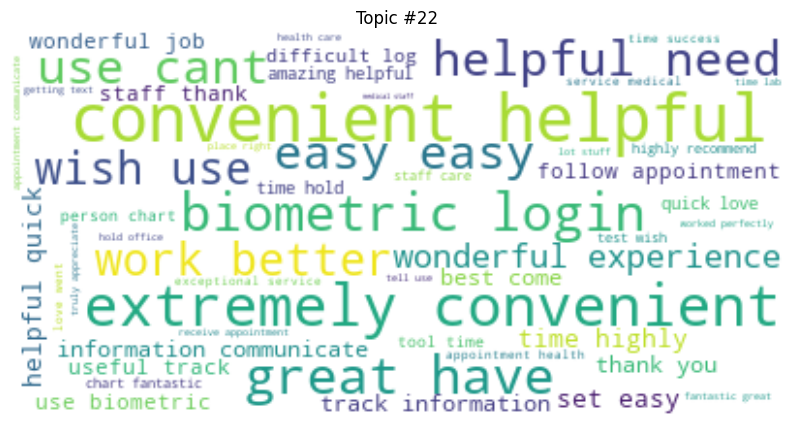

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


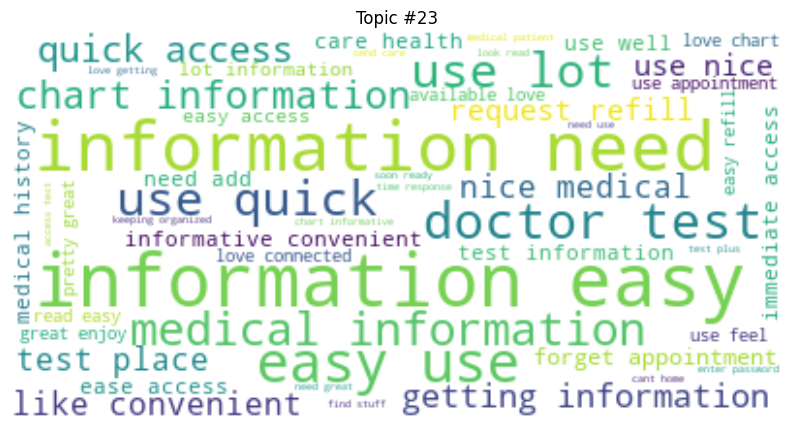

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


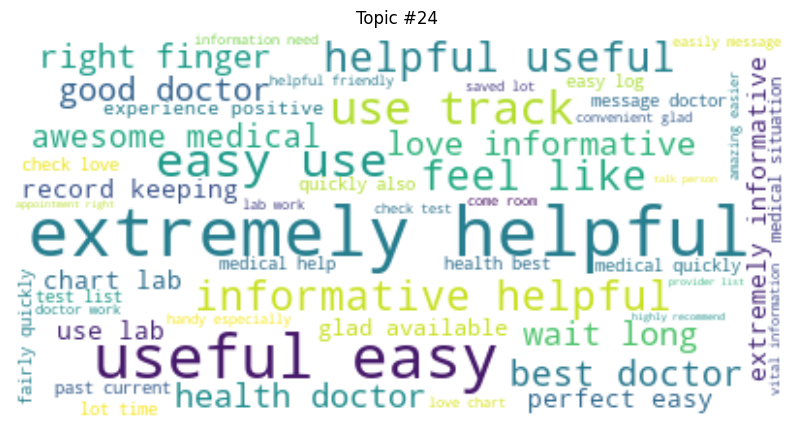

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


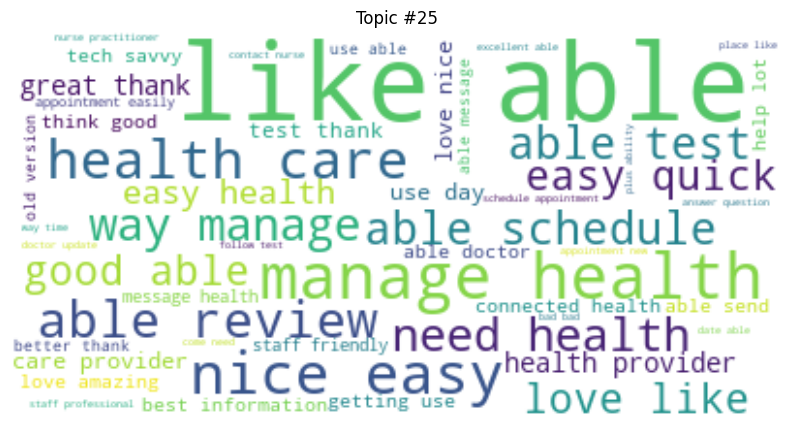

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


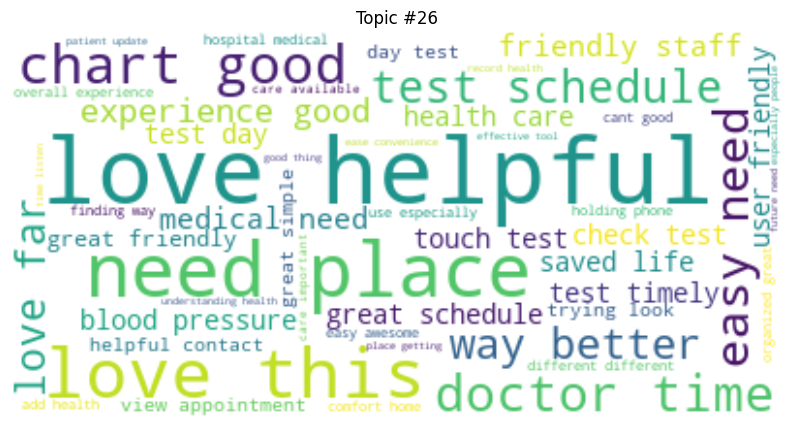

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


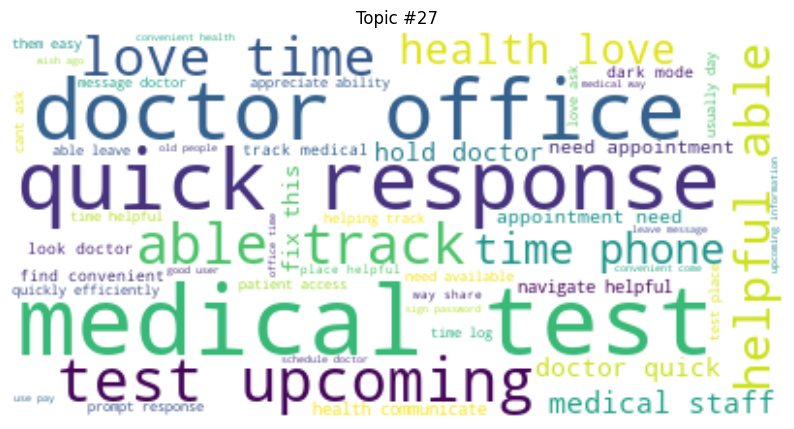

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


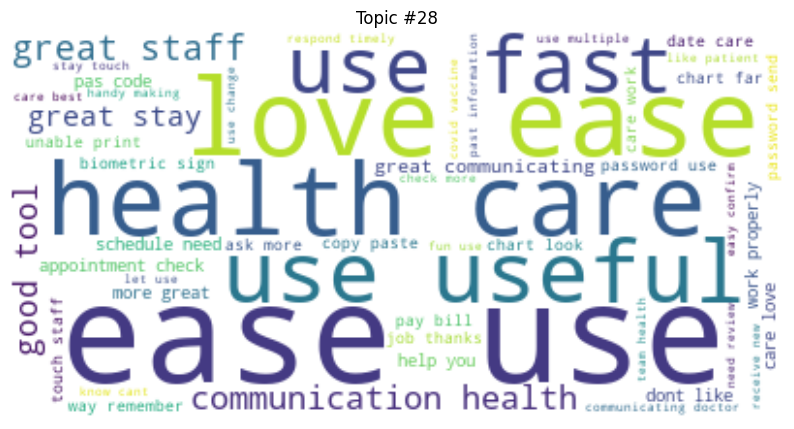

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


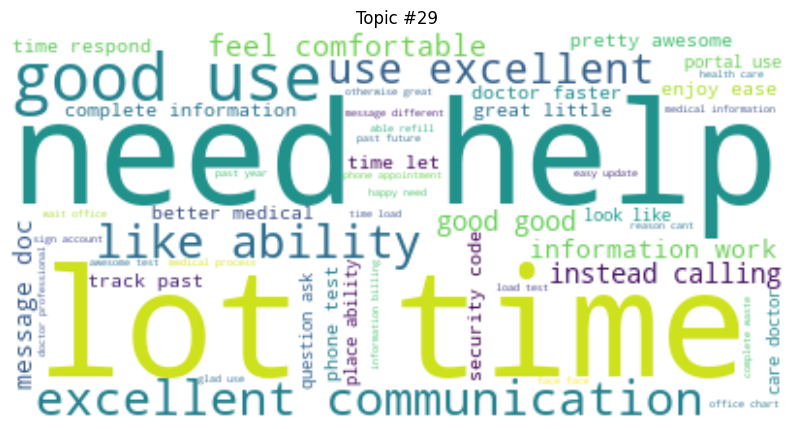

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


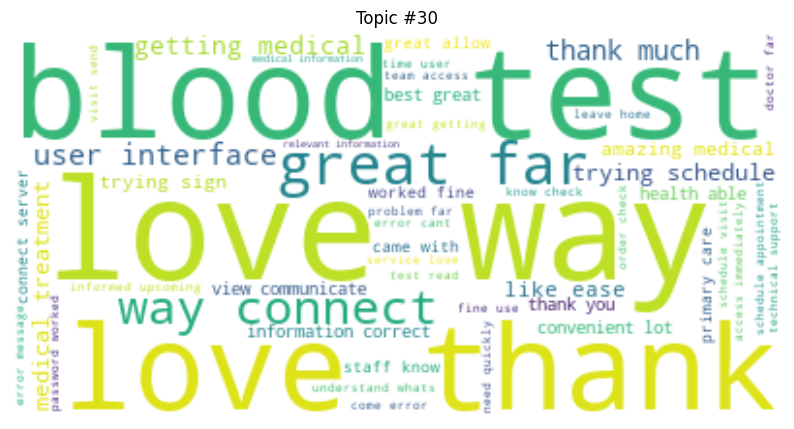

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


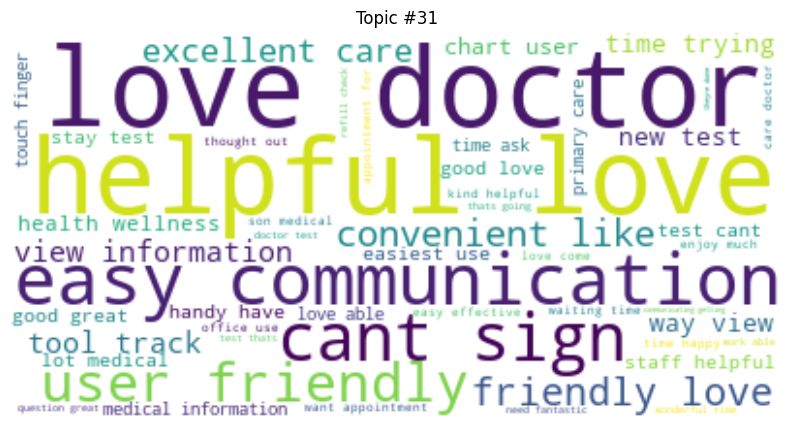

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


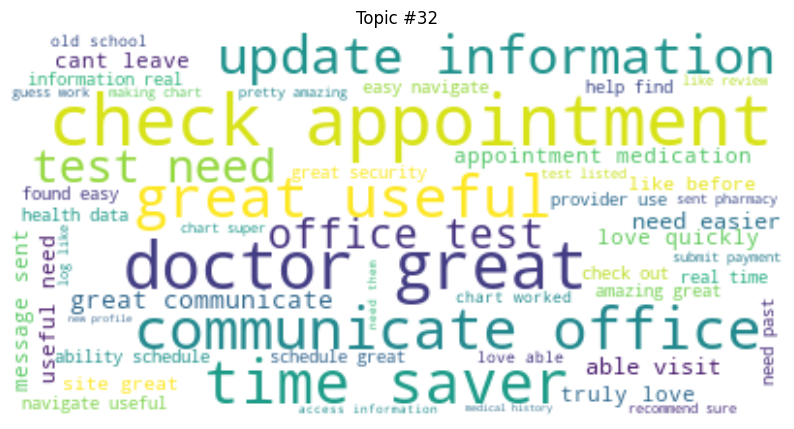

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


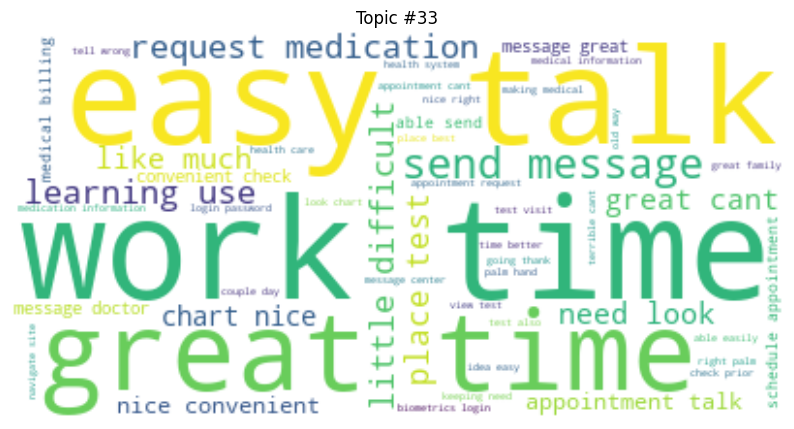

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


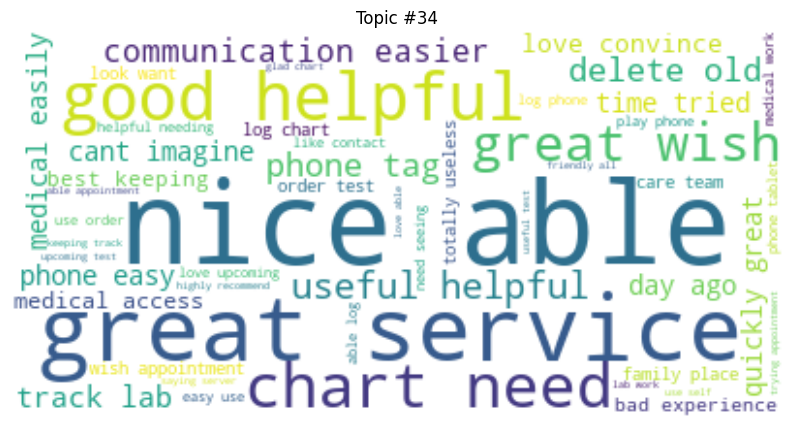

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


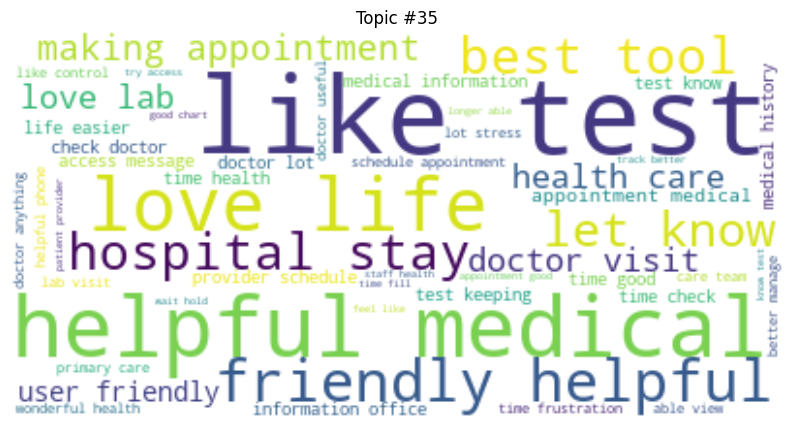

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


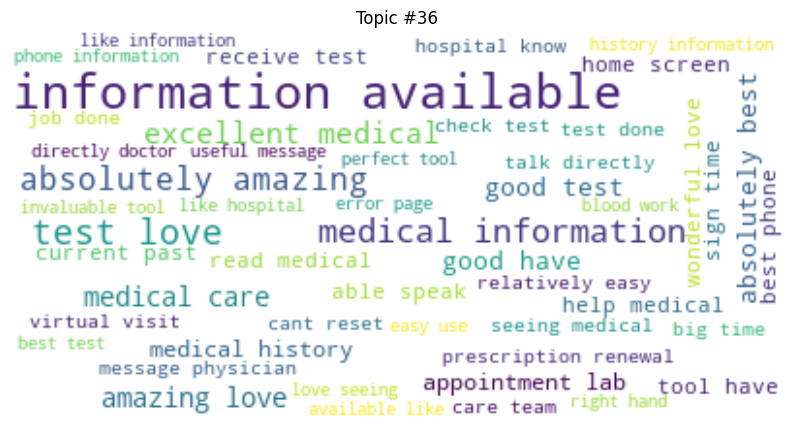

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


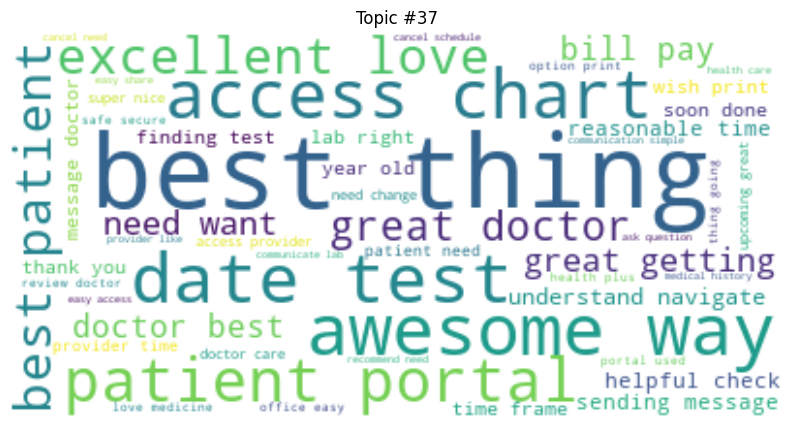

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


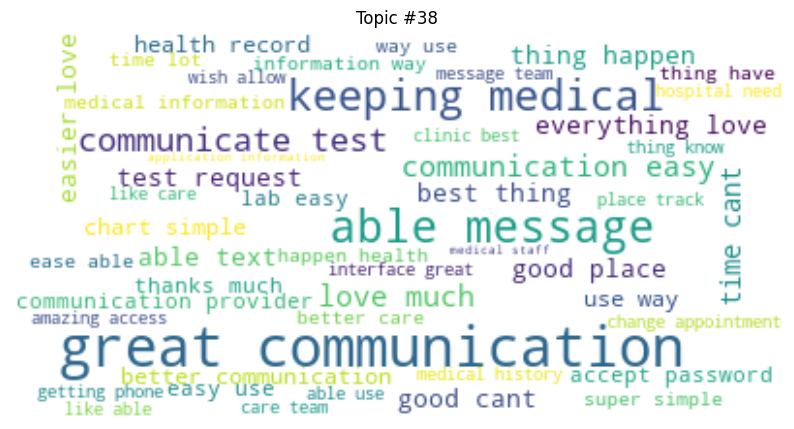

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


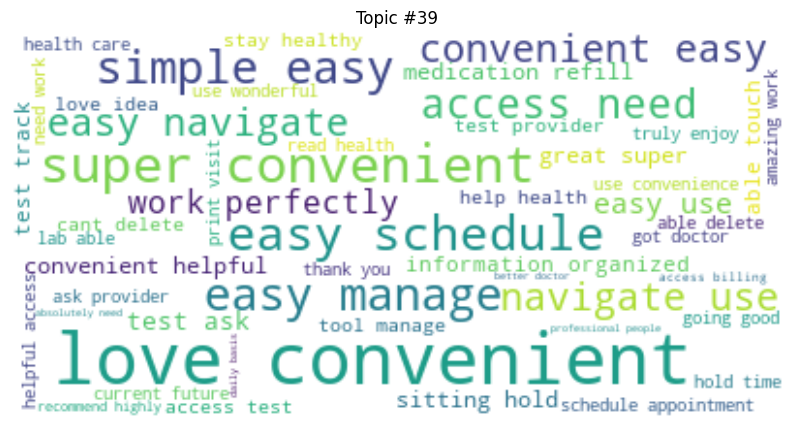

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


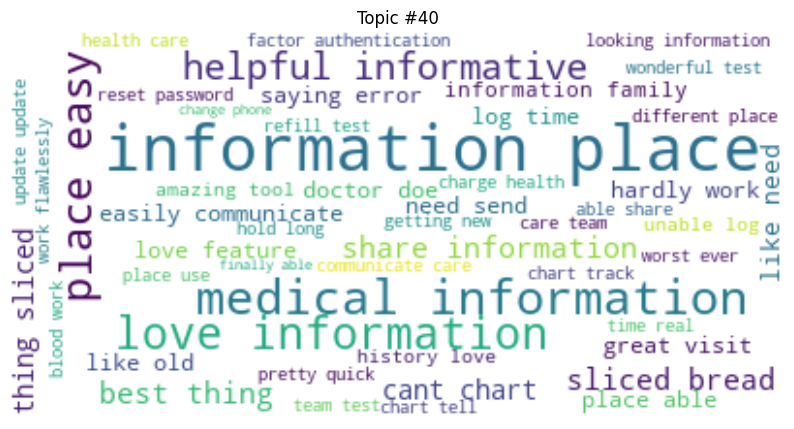

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


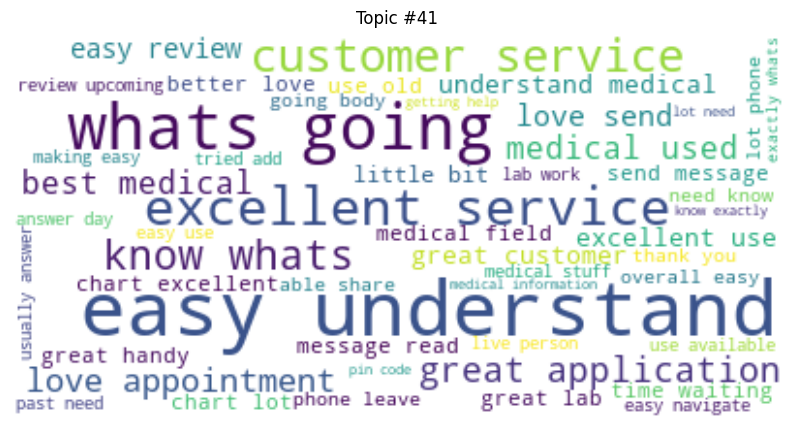

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


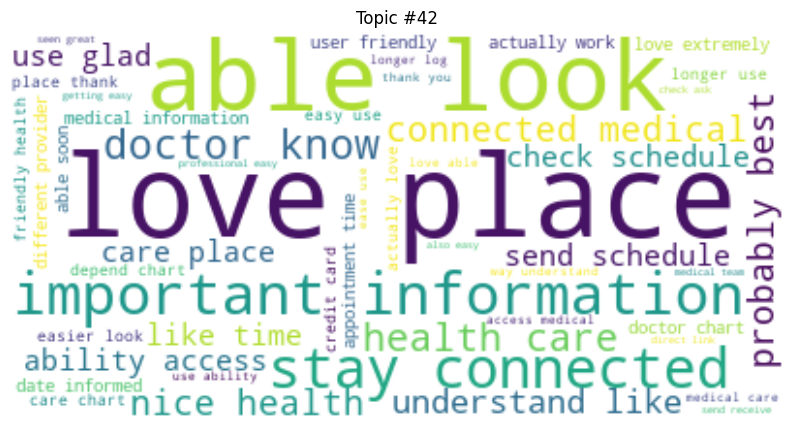

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


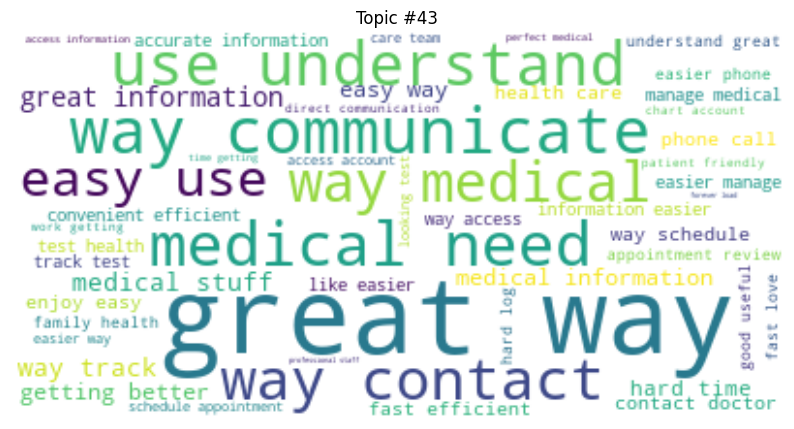

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


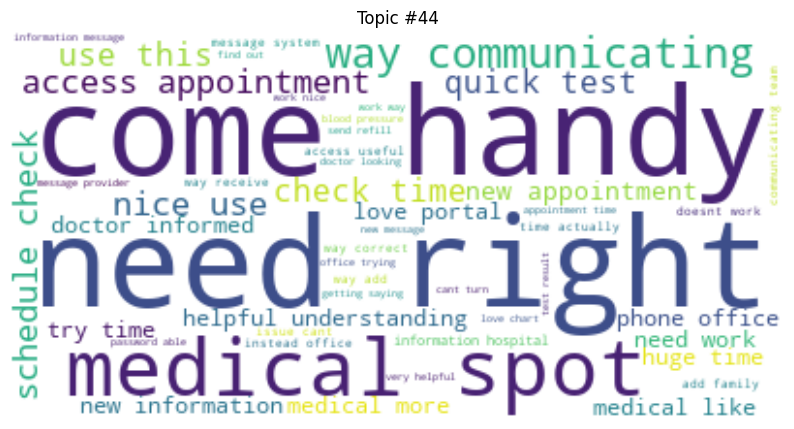

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


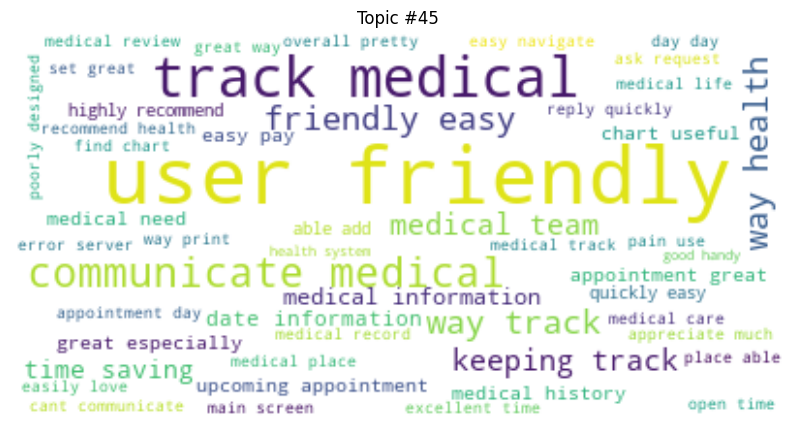

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


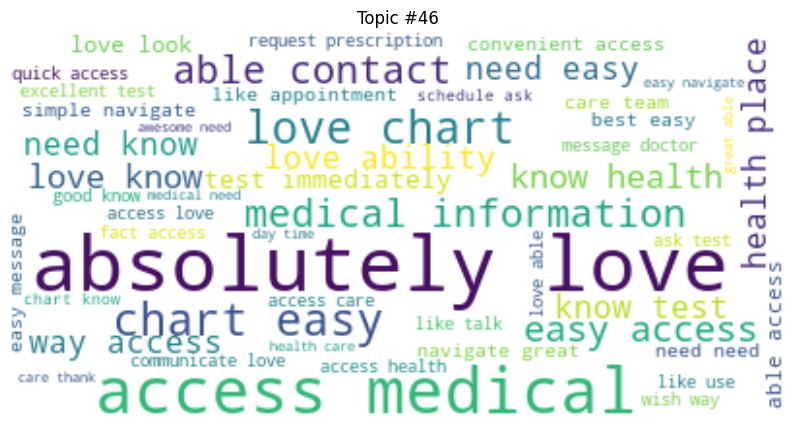

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


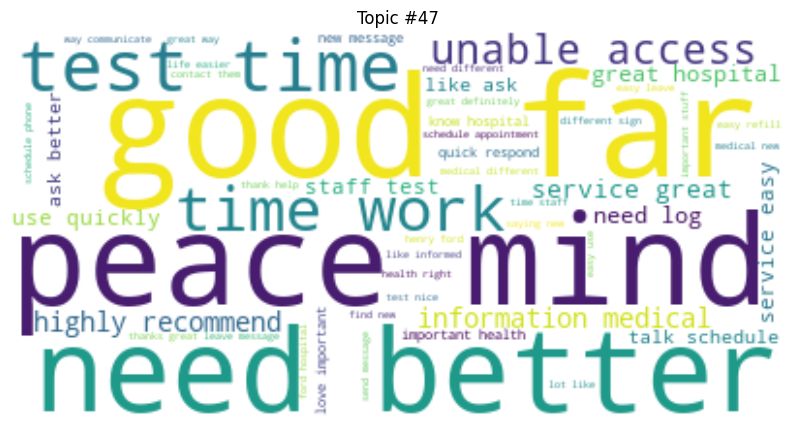

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


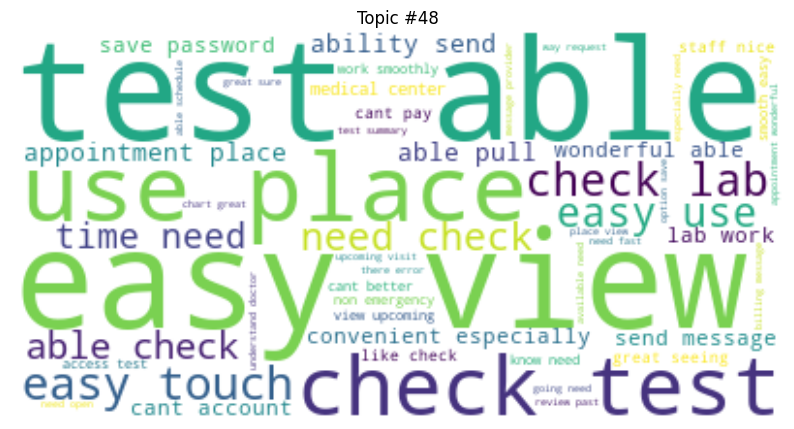

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


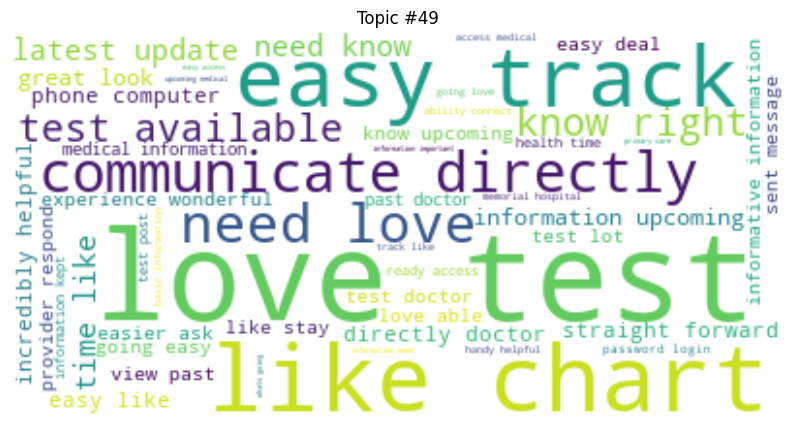

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


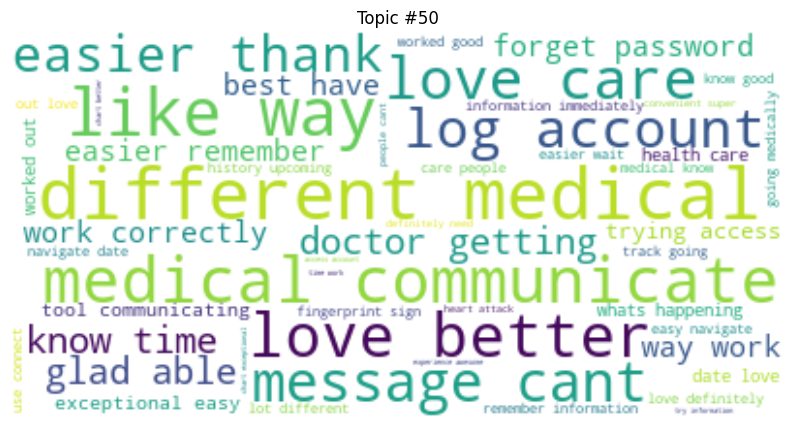

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


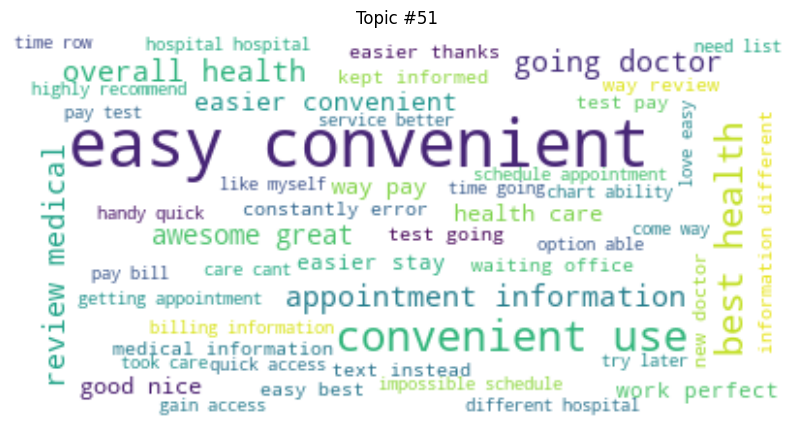

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


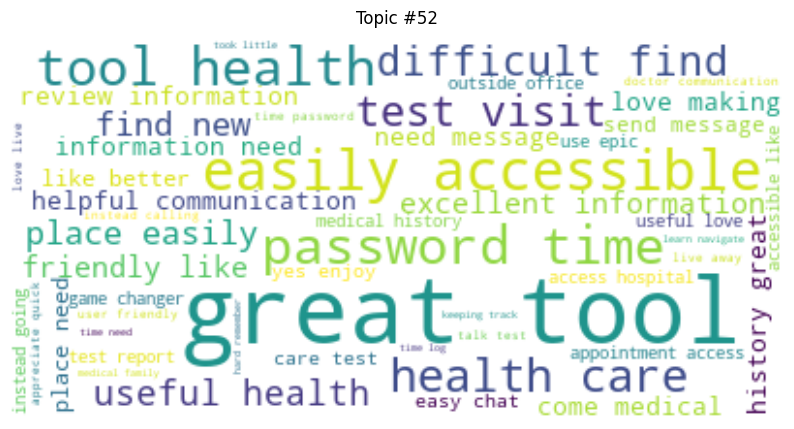

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


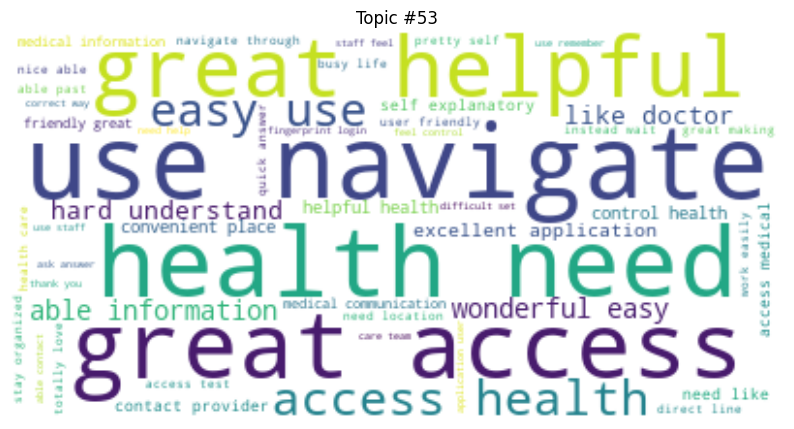

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


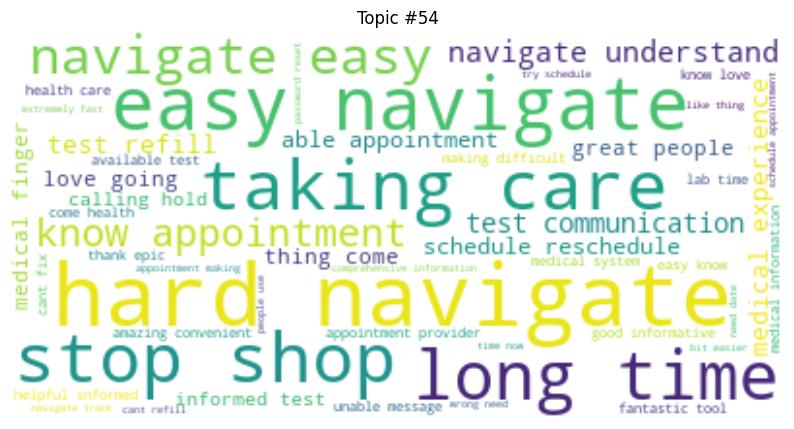

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


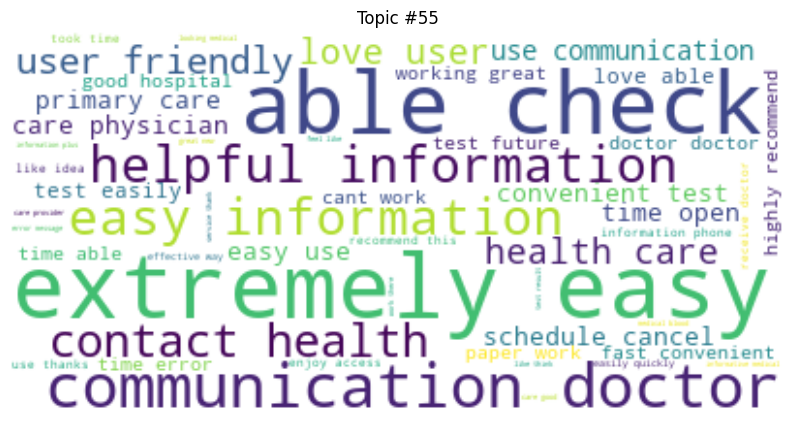

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


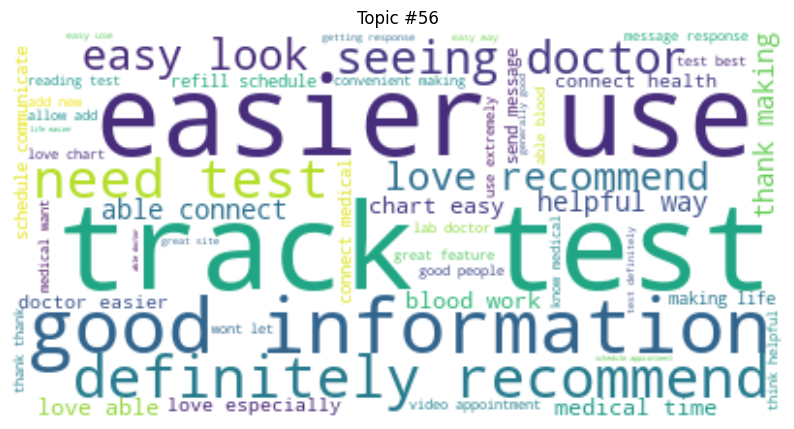

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


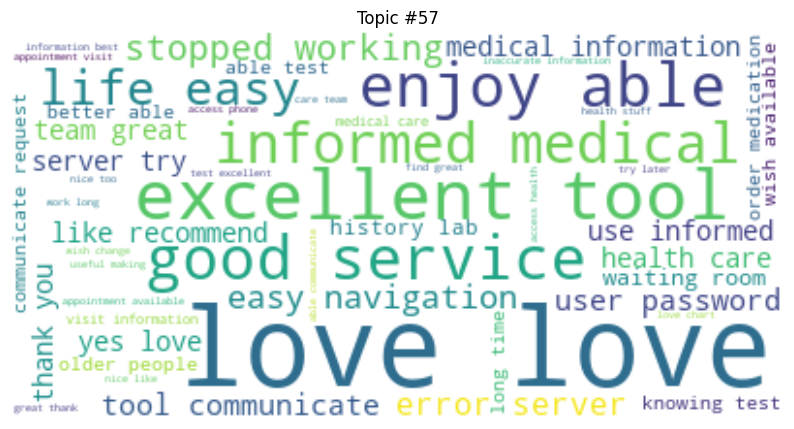

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


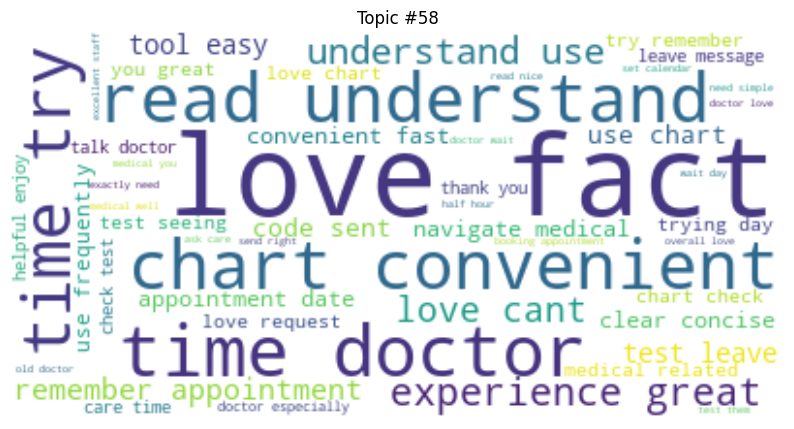

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


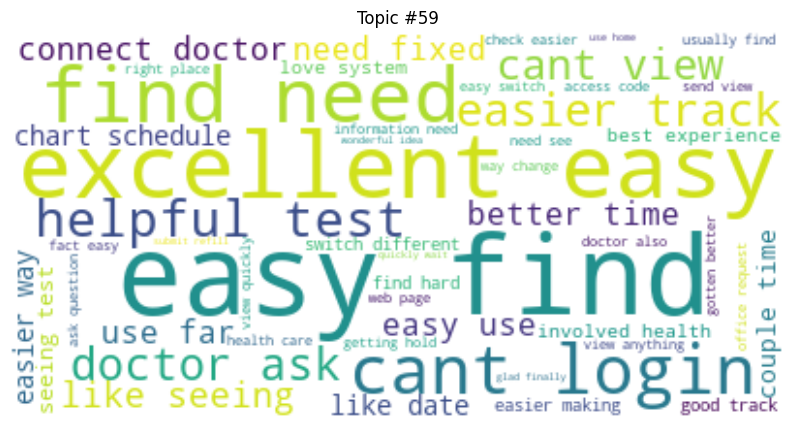

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


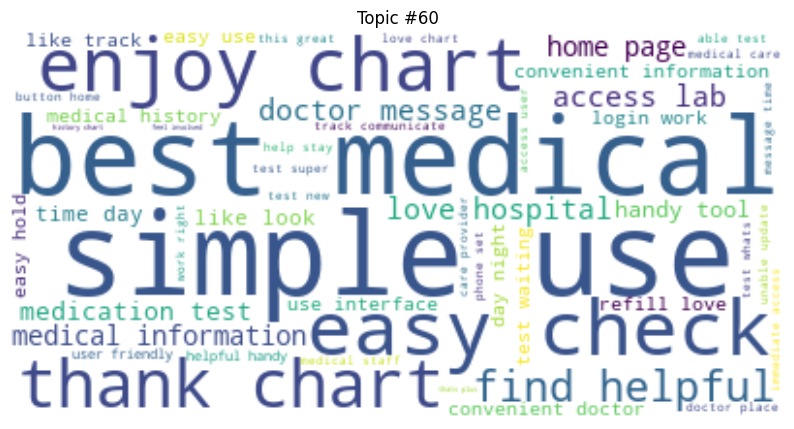

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


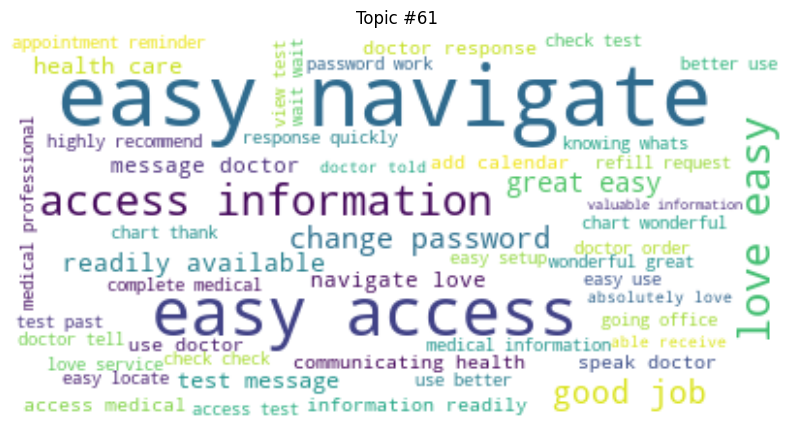

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


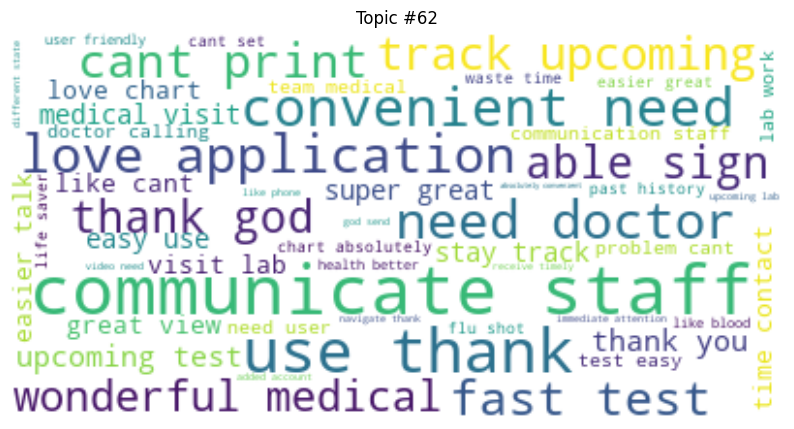

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


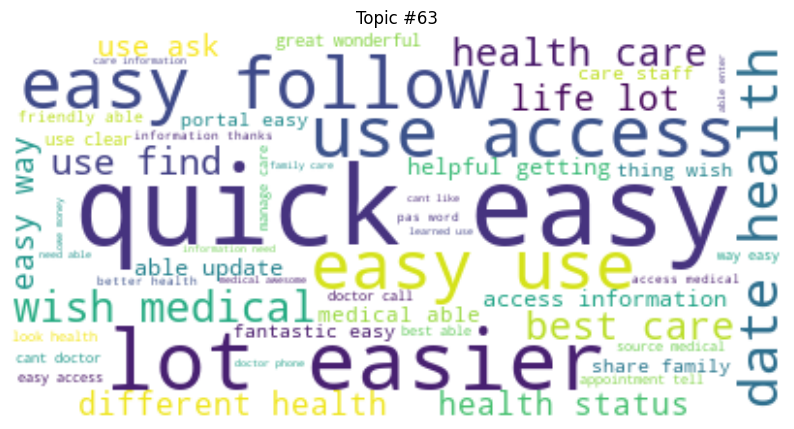

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


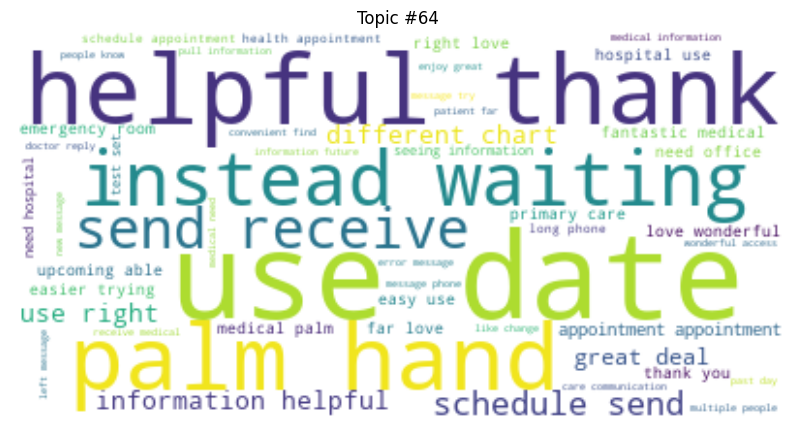

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


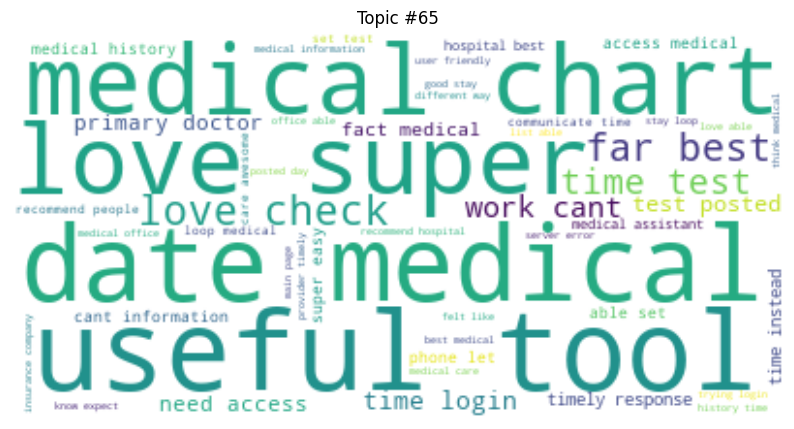

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


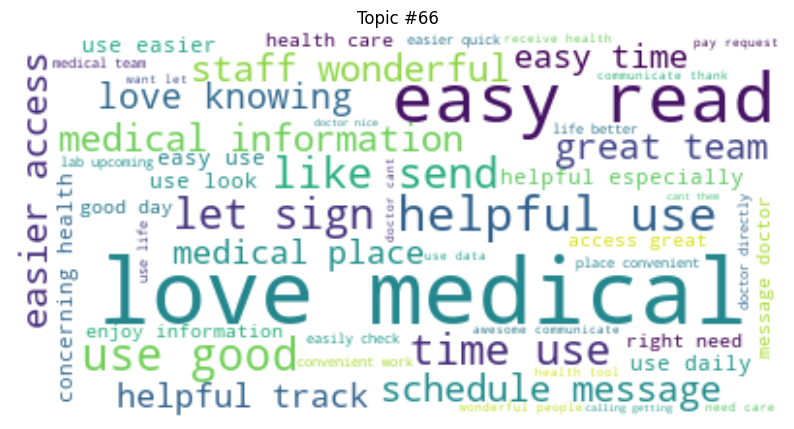

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


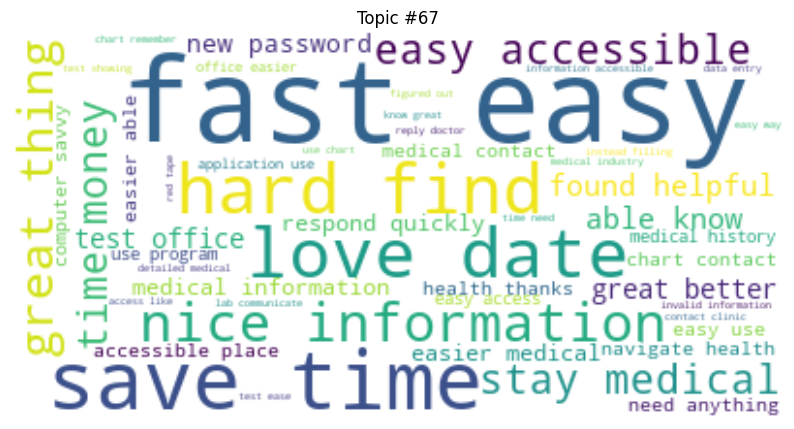

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


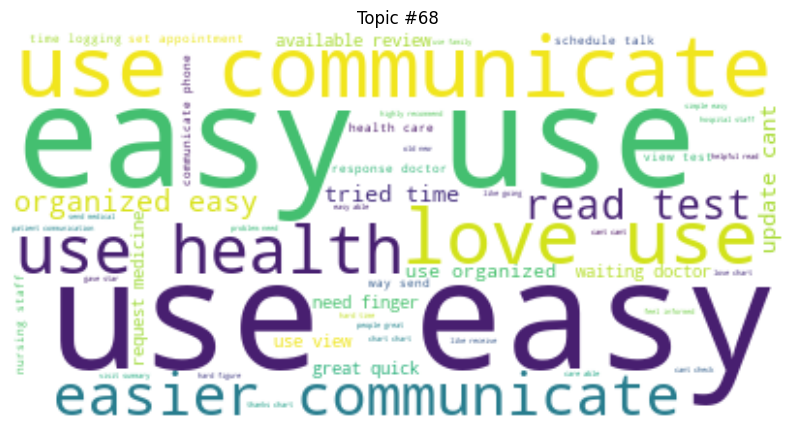

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


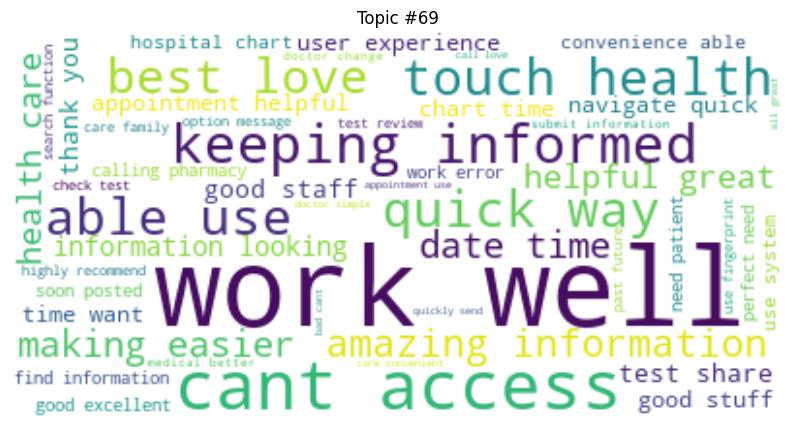

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


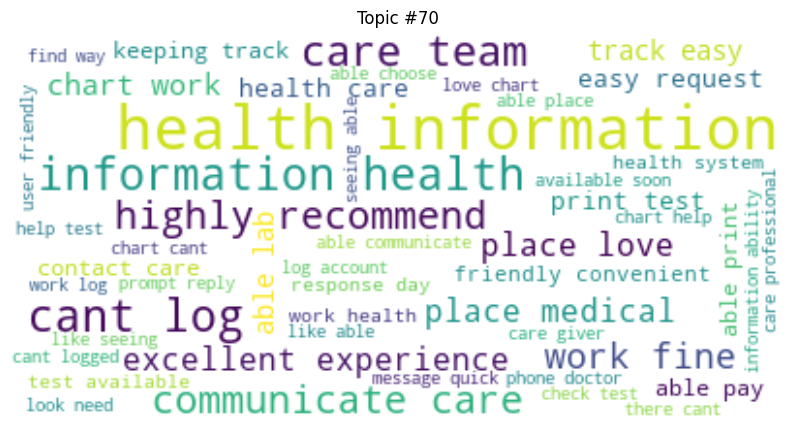

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


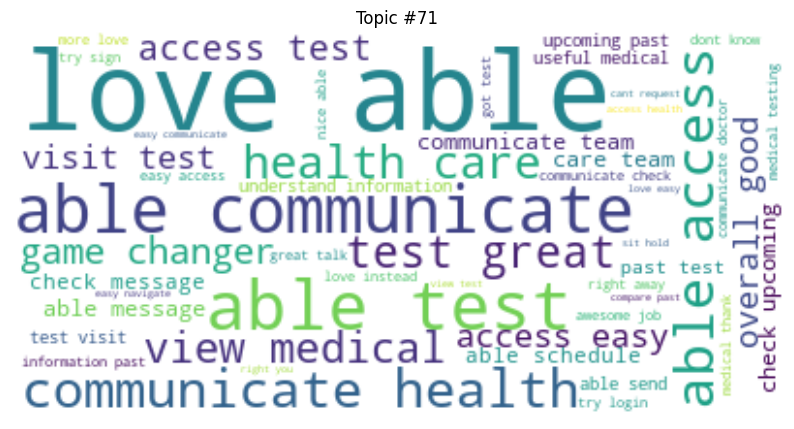

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


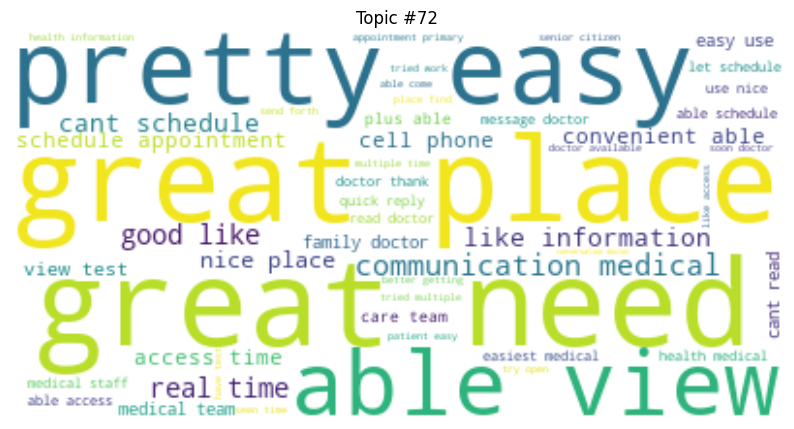

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


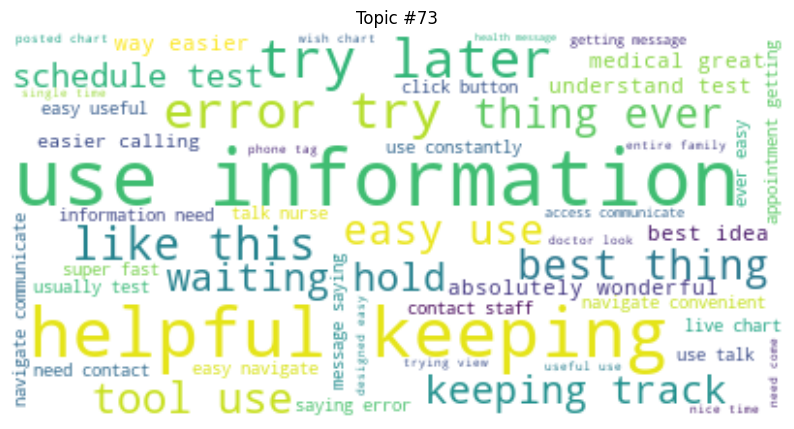

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


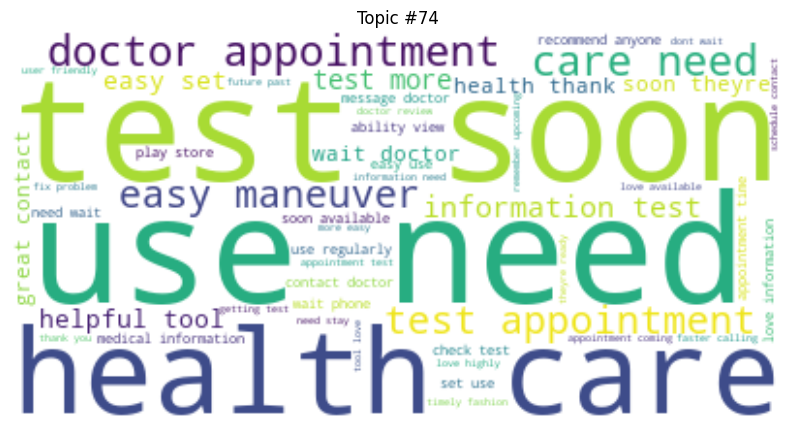

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


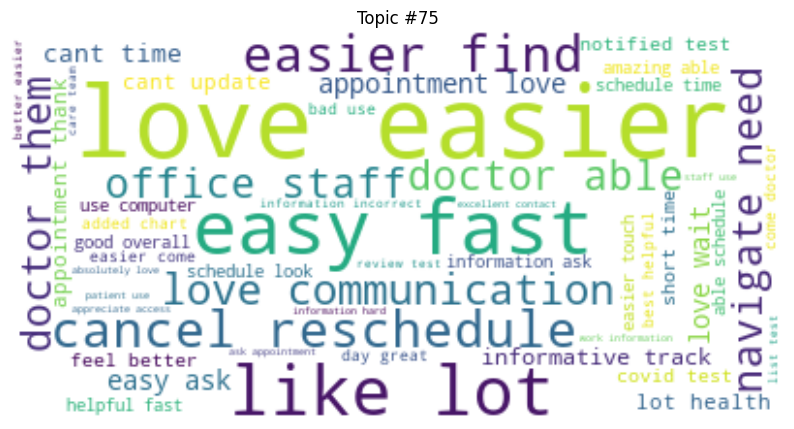

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


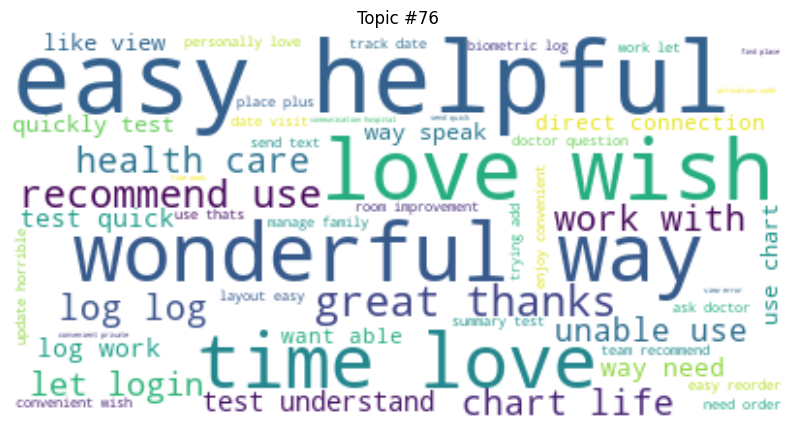

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


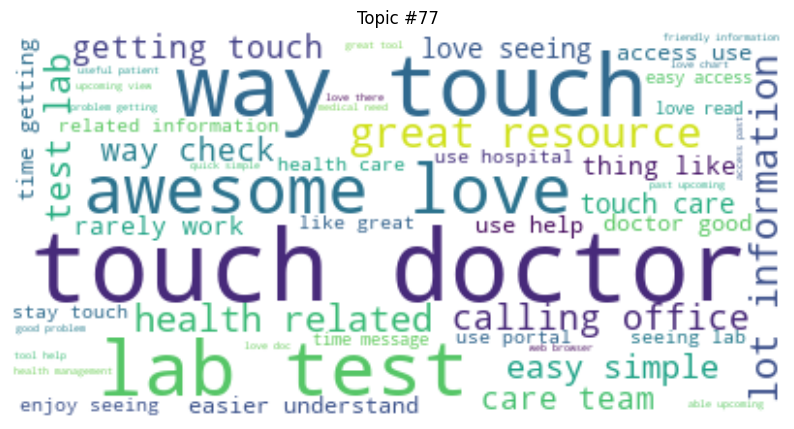

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


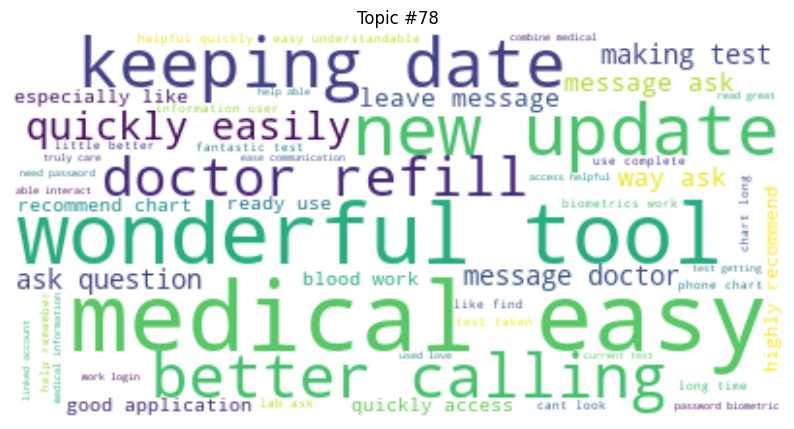

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


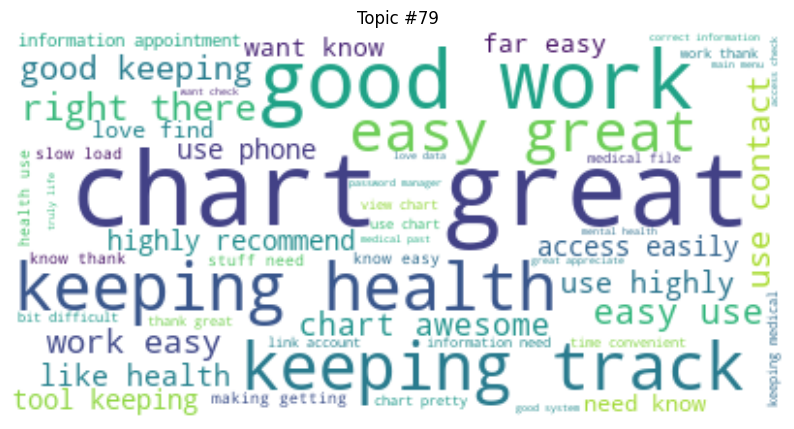

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


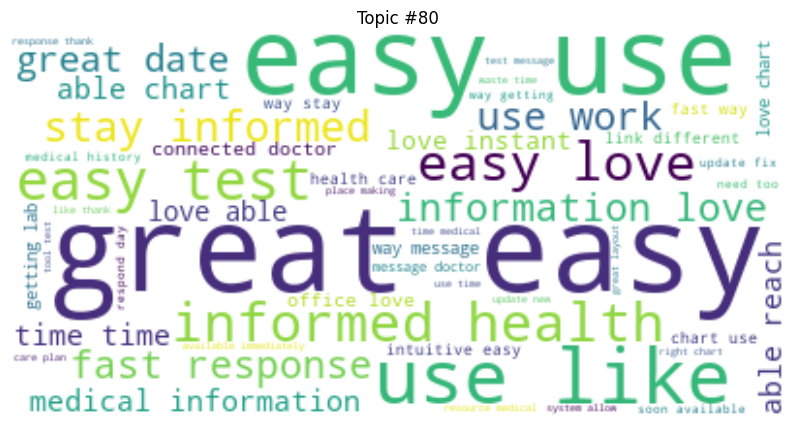

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


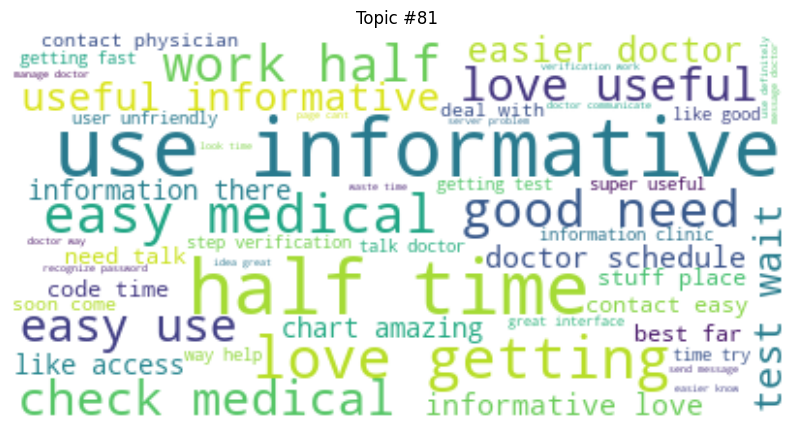

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


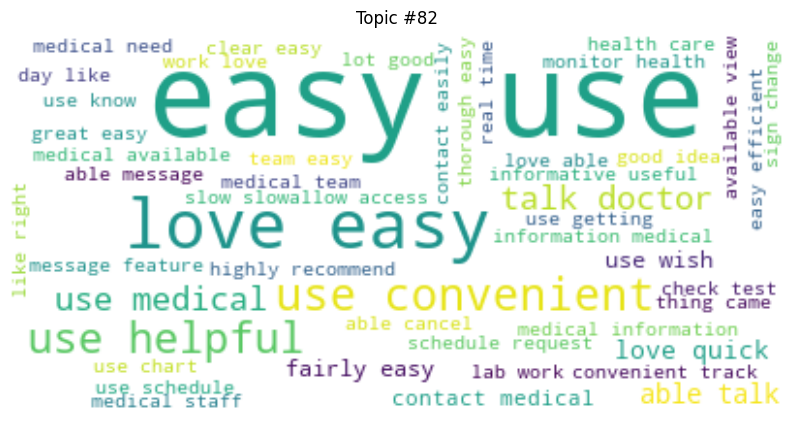

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


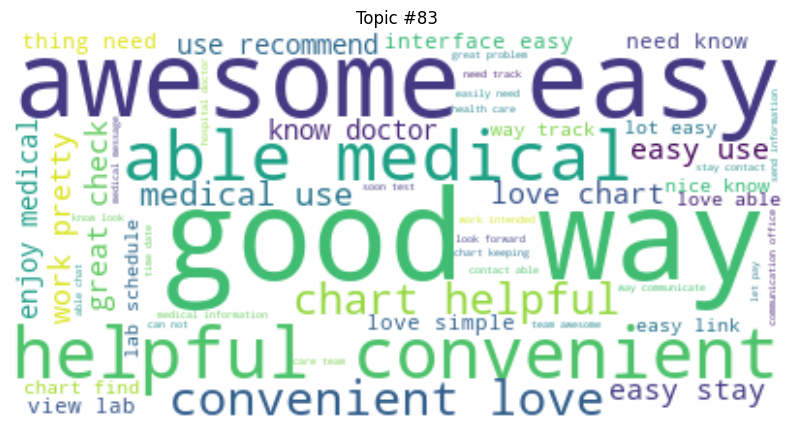

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


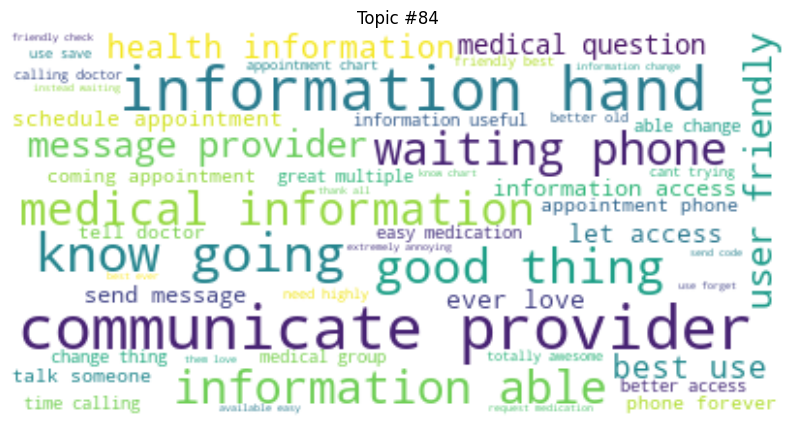

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


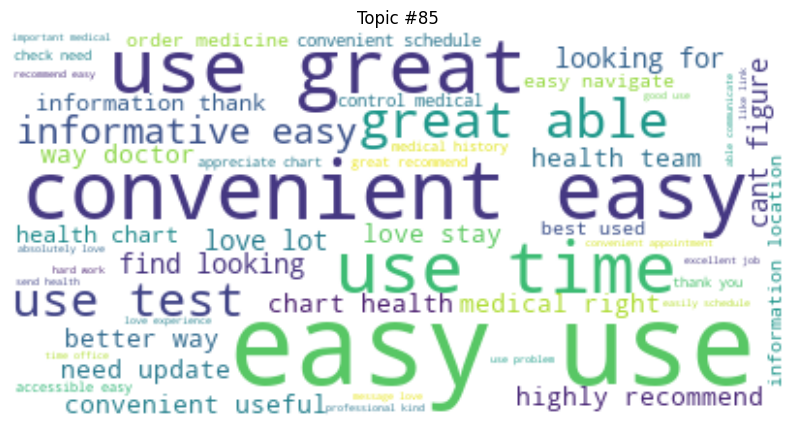

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


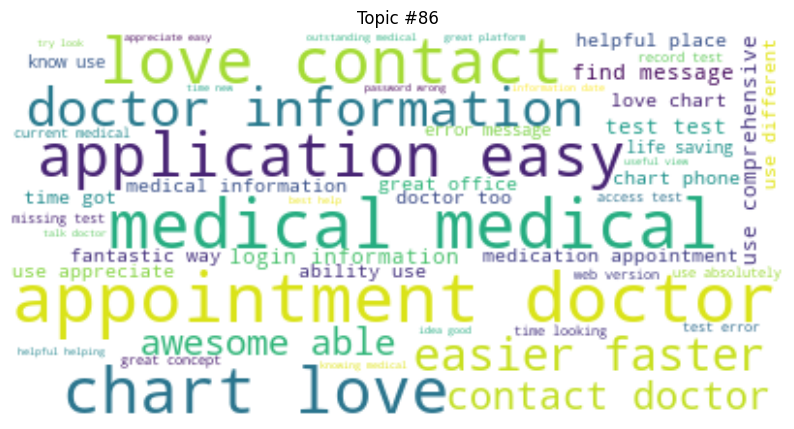

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


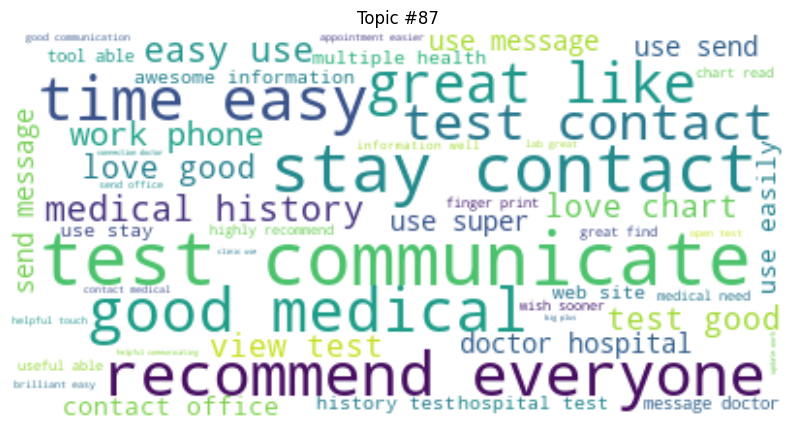

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


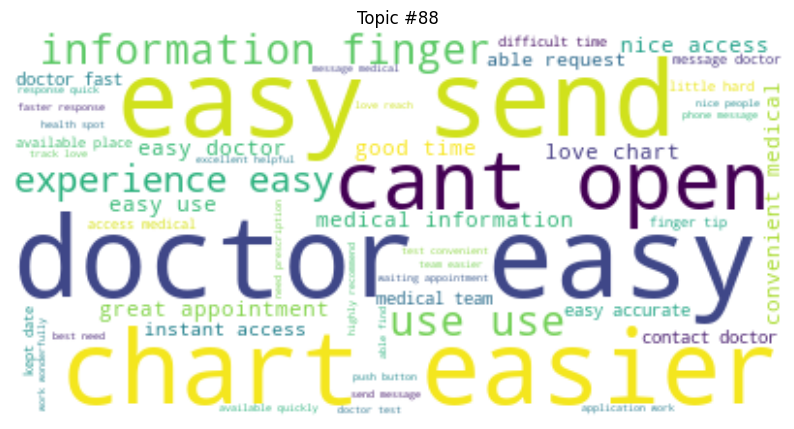

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


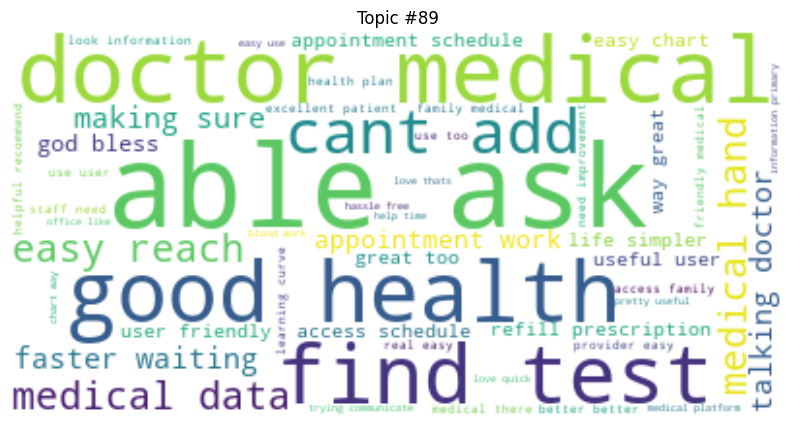

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


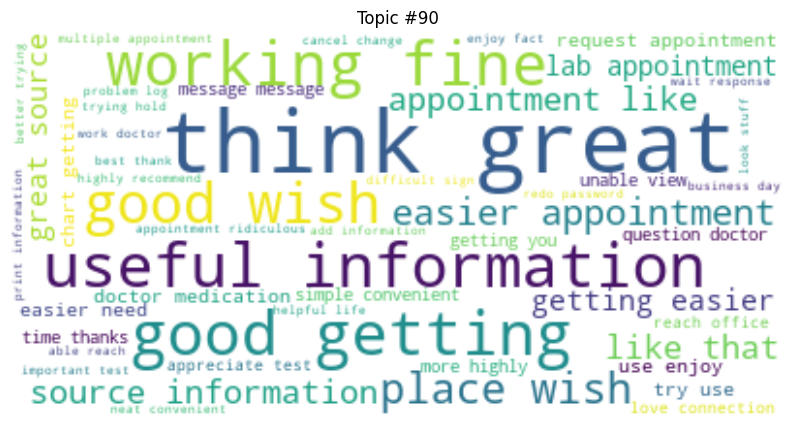

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


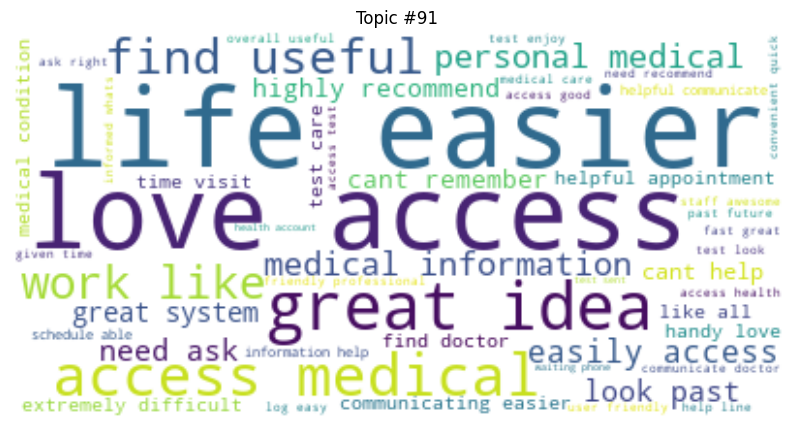

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


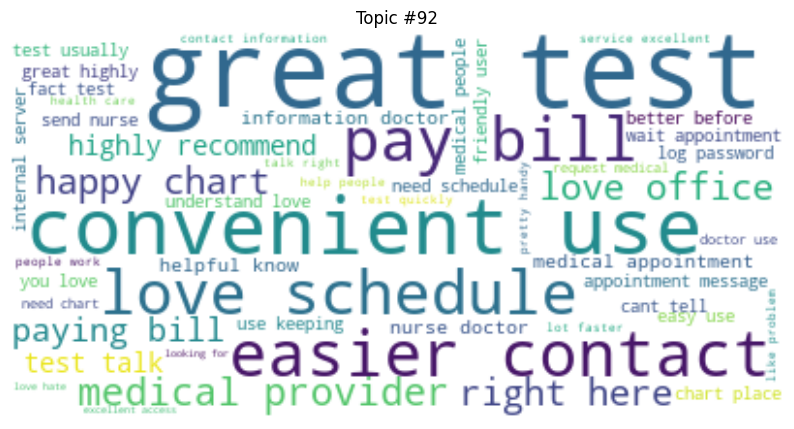

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


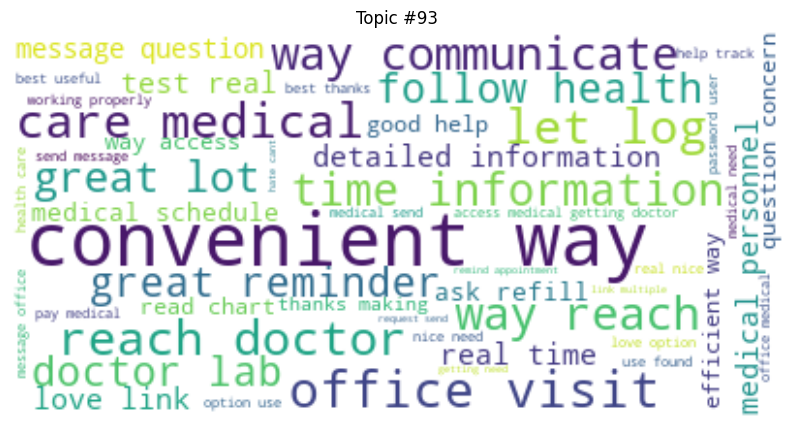

C:\Users\ahwah\anaconda3\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


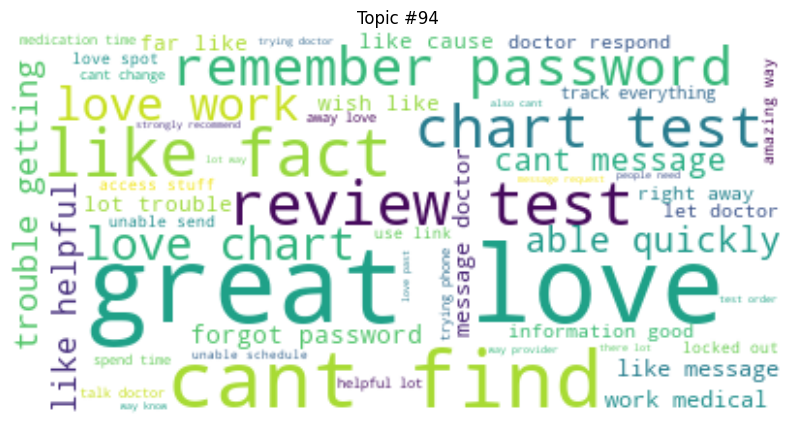

In [40]:
import os
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Check if the directory exists, and if not, create it
output_dir = "Word_Clouds"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for t in range(num_topics):
    plt.figure(figsize=(10,10))

    # Generate the word cloud data
    wc = WordCloud(background_color="white", max_words=50)
    topic_words = dict(model.show_topic(t, 200))  # Get top 200 words for the topic
    wc.generate_from_frequencies(topic_words)

    # Plot
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Topic #{t+1}")
    plt.show()

    # Save the word cloud to a file within the 'Clouds' folder
    wc.to_file(os.path.join(output_dir, f"topic_{t+1}_wordcloud.png"))
